In [285]:
%reload_ext autoreload
%autoreload 2


#This is needed to add the repo dir to the path so jupyter
# can load the republic modules directly from the notebooks
import os
import sys
import re
sys.path.append('/Users/rikhoekstra/develop/republic_clean/')

# from collections import defaultdict
import pandas as pd
from collections import Counter, defaultdict
import json
import republic.model.republic_document_model as rdm

repo_dir = os.path.split(os.getcwd())[0]

if repo_dir not in sys.path:
    sys.path.append(repo_dir)
    
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

In [286]:
from collections import Counter

In [12]:
import pandas as pd

SHEET_ID = '1SfsWJvToHaNpjxeT6mNkJ4lPwr0xm6kX'
SHEET_NAME = 'main_formulas'
url = f'https://docs.google.com/spreadsheets/d/{SHEET_ID}/export?format=tsv'
df = pd.read_csv(url, sep='\t')
df.head()

,frequency_rank,formula,commentaar/vragen,classificatie,gevolgd door,Classificatie_JR,Overlap
0,1,<START> ontfangen een missive van,NaN,proposition,naam,NaN,NaN
1,2,op geen resolutie is gevallen <END>,NaN,decision,-,NaN,NaN
2,3,waar op gedelibereert zynde is,NaN,decision,NaN,NaN,NaN
3,4,op gedelibereert zynde is goedgevonden en,NaN,decision,NaN,NaN,3
4,5,zynde is goedgevonden en verstaan dat,NaN,decision,NaN,NaN,3;4


In [15]:
flst = list(df.formula.str.split())
c = Counter()


In [16]:
for f in flst:
    c.update(f)

In [17]:
c.most_common()


[('van', 3671),
 ('de', 1939),
 ('den', 1709),
 ('en', 1545),
 ('te', 1250),
 ('haar', 962),
 ('mogende', 875),
 ('het', 795),
 ('in', 665),
 ('hoogh', 643),
 ('dat', 585),
 ('op', 553),
 ('aan', 488),
 ('hoog', 440),
 ('om', 383),
 ('ter', 346),
 ('der', 336),
 ('een', 329),
 ('mog', 315),
 ('heeren', 314),
 ('tot', 313),
 ('heere', 270),
 ('daar', 265),
 ('by', 251),
 ('missive', 239),
 ('ende', 208),
 ('requeste', 204),
 ('sal', 203),
 ('werden', 179),
 ('met', 177),
 ('ten', 171),
 ('geschreven', 170),
 ('als', 170),
 ('resolutie', 168),
 ('haer', 168),
 ('gedeputeerden', 161),
 ('houdende', 161),
 ('andere', 159),
 ('voorsz', 158),
 ('voor', 155),
 ('waar', 144),
 ('worden', 140),
 ('gedelibereert', 136),
 ('twintighsten', 136),
 ('vergaderinge', 131),
 ('voorschreve', 129),
 ('zynde', 126),
 ('s', 126),
 ('suppliant', 119),
 ('mits', 114),
 ('honderd', 110),
 ('sijne', 105),
 ('selver', 105),
 ('soo', 105),
 ('is', 104),
 ('na', 104),
 ('<END>', 103),
 ('verstaan', 101),
 ('mogen

In [287]:
from republic.helper.similarity_match import FuzzyKeywordGrouper

In [27]:
df_forms2 = pd.read_csv('/Users/rikhoekstra/Downloads/formulas/phrases-5_gram-18th_century.tsv.gz', compression='infer', sep='\t')

In [28]:
grouped = df_forms2.reset_index().groupby('doc_id')

In [639]:
df1757 = df_forms2.loc[df_forms2.doc_id.str.contains('1757')]

In [640]:
labels = ['small','medium','large','verylarge']

df1757['lcats'] = pd.cut(df1757.doc_len, [50,100,500,1000,100000],labels=labels)

In [641]:
df1757['lowphrase'] = df1757.phrase.str.lower()

In [291]:
gg = df1757.loc[df1757.lowphrase.str.contains('goe[dt]+gevonden', regex=True)][['doc_id','pos_start','lowphrase','lcats']]

In [292]:
gg[(gg.pos_start<=120) & (gg.lcats!='xsmall')].sort_values('pos_start')

,doc_id,pos_start,lowphrase,lcats
18112399,session-1757-06-02-num-1-resolution-5,7,is na voorgaande deliberatie goedgevonden,NaN
18093310,session-1757-01-11-num-1-resolution-8,7,is na voorgaande deliberatie goedgevonden,medium
18102319,session-1757-04-12-num-1-resolution-23,7,is na voorgaande deliberatie goedgevonden,NaN
18112400,session-1757-06-02-num-1-resolution-5,8,na voorgaande deliberatie goedgevonden en,NaN
18093311,session-1757-01-11-num-1-resolution-8,8,na voorgaande deliberatie goedgevonden en,medium
...,...,...,...,...
18066104,session-1757-03-01-num-1-resolution-11,120,gedelibereert zynde is goedgevonden en,medium
18133319,session-1757-10-26-num-1-resolution-5,120,is goedgevonden en verstaan mits,medium
18137269,session-1757-08-10-num-1-resolution-3,120,na voorgaande deliberatie goedgevonden en,medium
18028189,session-1757-01-05-num-1-resolution-7,120,op gedelibereert zynde is goedgevonden,medium


In [293]:
gg.pos_start.median()

157.0

In [35]:
waar_phrase = df1757.loc[df1757.lowphrase.str.find('waar')==0]

In [36]:
waar_phrase[['doc_id','pos_start']]

,doc_id,pos_start
17991902,session-1757-02-07-num-1-resolution-11,226
17992008,session-1757-02-07-num-1-resolution-12,131
17992031,session-1757-02-07-num-1-resolution-12,202
17992078,session-1757-02-07-num-1-resolution-12,365
17992100,session-1757-02-07-num-1-resolution-12,443
...,...,...
18241776,session-1757-12-19-num-1-resolution-13,192
18241874,session-1757-12-19-num-1-resolution-14,111
18242009,session-1757-12-19-num-1-resolution-16,114
18242071,session-1757-12-19-num-1-resolution-16,393


In [37]:
fields = ["doc_id","lowphrase_x","lowphrase_y","pos_start_x","pos_start_y",
          "rel_pos_start","pos_end","rel_pos_end","phrase_freq","length_bin","lcats","doc_len",]

In [38]:
merged = pd.merge(left=waar_phrase, right=gg, left_on='doc_id', right_on='doc_id')

In [39]:
groped = merged.groupby('doc_id').agg({'lowphrase_x':lambda x: x.iat[0],
                             'lowphrase_y':lambda x: x.iat[0],
                             'pos_start_x':lambda x: x.iat[0],
                             'pos_start_y':list})

In [40]:
ybeforex = merged.loc[merged.pos_start_x>merged.pos_start_y].groupby('doc_id').agg({'lowphrase_x':lambda x: x.iat[0],
                             'lowphrase_y':lambda x: x.iat[0],
                             'pos_start_x':lambda x: x.iat[0],
                             'pos_start_y':max})

In [41]:
ybeforex

,lowphrase_x,lowphrase_y,pos_start_x,pos_start_y
doc_id,,,,
session-1757-01-07-num-1-resolution-9,waar op gedelibereert zynde is,op gedelibereert zynde is goedgevonden,408,245
session-1757-01-11-num-1-resolution-10,waar in de republicq sigh,dien onvermindert goedgevonden de gecommitteer...,363,321
session-1757-01-11-num-1-resolution-11,waar van de onkosten by,goedgevonden en verstaan dat om,165,139
session-1757-01-11-num-1-resolution-8,waar meede haar hoogh mogende,is na voorgaande deliberatie goedgevonden,54,11
session-1757-01-28-num-1-resolution-5,waar op gedelibereert zynde is,op gedelibereert zynde is goedgevonden,433,397
...,...,...,...,...
session-1757-12-20-num-1-resolution-10,waar toe het selve fonds,op gedelibereert zynde is goedgevonden,957,672
session-1757-12-22-num-1-resolution-4,waar in de supplianten soo,op gedelibereert zynde is goedgevonden,320,242
session-1757-12-22-num-1-resolution-5,waaren en dat hy oock,goedgevonden hebbende om door desselfs,323,44


In [42]:
from republic.elastic.republic_elasticsearch import initialize_es
rep_es = initialize_es(host_type="external")

In [43]:
ybeforex.lowphrase_x.value_counts()

waar op gedelibereert zynde is         43
waar op gedelibereert zynde hebben     12
waar op geen resolutie is               9
waar van den raad van                   6
waarde van de uyt te                    5
                                       ..
waar onder deese provincie meede        1
waar wan in de memorie                  1
waar in haar hoogh mogende              1
waaren te gebruycken en specialijck     1
waar by aan haar om                     1
Name: lowphrase_x, Length: 80, dtype: int64

In [294]:
starts = df1757[df1757.lowphrase.str.contains('<start>') & ~df1757.doc_id.str.contains('attendance', regex=True)]

In [295]:
starts

,phrase,doc_id,doc_len,pos_start,rel_pos_start,pos_end,rel_pos_end,phrase_freq,length_bin,lcats,lowphrase
17991801,<START> ONtfangen een Missive van,session-1757-02-07-num-1-resolution-11,257,0,0.0,252,0.980545,122917,6.0,medium,<start> ontfangen een missive van
17991929,<START> ONtfangen een Missive van,session-1757-02-07-num-1-resolution-12,493,0,0.0,488,0.989858,122917,6.0,medium,<start> ontfangen een missive van
17992172,<START> ONtfangen een Missive van,session-1757-02-08-num-1-resolution-1,255,0,0.0,250,0.980392,122917,6.0,medium,<start> ontfangen een missive van
17992302,<START> IS ter Vergaderinge geleesen,session-1757-02-08-num-1-resolution-4,110,0,0.0,105,0.954545,17339,5.0,medium,<start> is ter vergaderinge geleesen
17992434,<START> ONtfangen een Missive van,session-1757-02-09-num-1-resolution-1,41,0,0.0,36,0.878049,122917,4.0,NaN,<start> ontfangen een missive van
...,...,...,...,...,...,...,...,...,...,...,...
18241705,<START> ONtfangen een Missive van,session-1757-12-19-num-1-resolution-13,266,0,0.0,261,0.981203,122917,6.0,medium,<start> ontfangen een missive van
18241836,<START> ONtfangen een Missive van,session-1757-12-19-num-1-resolution-14,162,0,0.0,157,0.969136,122917,5.0,medium,<start> ontfangen een missive van
18241913,<START> IS ter Vergaderinge geleesen,session-1757-12-19-num-1-resolution-15,260,0,0.0,255,0.980769,17339,6.0,medium,<start> is ter vergaderinge geleesen
18241981,<START> IS ter Vergaderinge geleesen,session-1757-12-19-num-1-resolution-16,668,0,0.0,663,0.992515,17339,7.0,large,<start> is ter vergaderinge geleesen


In [296]:
nostarts = df1757[~df1757.lowphrase.str.contains('<start>')]

In [297]:
starts.doc_len.mean()

199.12584175084174

In [48]:
grouped = starts.groupby(['lowphrase'])
agg_group = grouped.agg({'doc_id':'count'})

In [298]:
from republic.formulas.frmls.clustering import kluster

In [657]:
from more_itertools import sliding_window, split_when

In [658]:
def gaps(row):
    gps = {}
    rn = [i[0] for i in row]
    adj = [(e[0], e[-1]) for e in list(split_when(rn, lambda a, b: a + 1 != b))]
    for i in sliding_window(adj,n=2):
        e1 = i[0][-1]
        e2 = i[1][0]
        gps[e1] = e2-e1
    return gps #, adj

In [659]:
def chn(row):
    result = [row[0]]
    try:
        for i in enumerate(row[1:]):
            prelement = row[i[0]-1]
            print (prelement)
            element = i[1]
            print(element)
            if element[0]>prelement[1]:
                print('joined', (prelement[1],element[1]))
                result.append((prelement[1],element[1]))
    except TypeError:
        print(row[1:])
    return result

In [729]:
def find_continuation(row, findstring=''):
    # print(row)
    m = -1
    res = [item[0] for item in enumerate(row.lowphrase) if item[1].lower().find(findstring.lower())>-1]
    if len(res)>0:
        m = max(res)
        try:
            if m in row.gaps.keys():
                return row.lowphrase[row.gaps[m]]
        
        except IndexError:
            pass

In [709]:
# not sure what this or next function does anymore
def trstr(s1,s2):
    rst = []
    i = len(s2)-1
    while i>-1:
        rst += s2[i]
        if s2[:i] in s1:
            break
        i -= 1
    if i == 1:
        rst += s2[i-1]  
    rst.reverse()
    return ''.join(rst)


def l2f(r):
    result = []
    trail = [r[0]]
    for el in sliding_window(r,n=2):
        res = trstr(el[0],el[1])
        if res == el[1]:
            # print(el[1],trail)
            result.append(trail)
            trail = [el[1]]
        else:
            trail.append(res)
    result.append(trail)
    return result

In [710]:
class DFGrouper(object):
    def __init__(self, df):
        self.df = df

    def kw2groups(self, keyword='', contains='contains', with_attendance=False):
        df = self.df
        if not 'lowphrase' in df.columns:
            df['lowphrase'] = df.phrase.str.lower()
        if with_attendance==False:
            df = df.loc[~df.doc_id.str.contains('attendance', regex=True)]
        if contains=='contains':
            sdf = df.loc[df.lowphrase.str.contains(keyword)]
        elif contains=='start':
            sdf = df.loc[df.lowphrase.str.startswith(keyword)]
        elif contains=='end':
            sdf = df.loc[df.lowphrase.str.endswith(keyword,regex=True)]
        grouped = sdf.groupby(['lowphrase'])
        agg_group = grouped.agg({'doc_id':'count'})
        return agg_group

    def fuzzy_groups(self, keyword='', contains='contains', with_attendance=False):
        df = self.kw2groups(keyword=keyword, contains=contains, with_attendance=with_attendance)
        df = FuzzyKeywordGrouper(list(df.index)).vars2graph()
        fgroups = {e:i[0] for i in enumerate(df) for e in i[1]}
        return fgroups
    
    def klustergroups(self, keyword='', contains='contains', with_attendance=False):
        wdf = self.kw2groups(keyword=keyword, contains=contains, with_attendance=with_attendance)
        wresult = kluster(wdf)
        wgresult = wresult.agg({'lowphrase': ['unique', 'nunique', 'count']})
        return wgresult
    
    def dictgroup(self, kw, groupname, contains='contains', with_attendance=False):
        """this add groups on an automatic keyword grouping based on fuzzygrouper.
        It should be made configurable using more standardized groups (e.g. made by hand)
        """
        kwdict = {}
        kwgr = self.fuzzy_groups(kw, contains=contains, with_attendance=False)
        self.df[groupname] = self.df.lowphrase.map(kwgr)
        for i in self.df[groupname].unique():
            ires = self.df.loc[self.df[groupname]==i].groupby('lowphrase').agg('count')
            if len(ires)>0:
                ndx = ires.idxmax()
                kwdict[i]=ndx.iat[0]
        self.df[f'standard_{groupname}'] = self.df[groupname].map(kwdict)
    
    

In [711]:
gr = DFGrouper(df1757)

In [912]:
gr.dictgroup(kw='heeft dienvolgende sessie',groupname='welkom')

In [913]:
gr.df['be'] = gr.df.apply(lambda row: (row.pos_start, row.pos_end), axis=1)

In [914]:
wkm=gr.df.loc[gr.df.welkom.notna()].sort_values(['doc_id','pos_start'])

wk

In [919]:
wkm

,phrase,doc_id,doc_len,pos_start,rel_pos_start,pos_end,rel_pos_end,phrase_freq,length_bin,lcats,lowphrase,welkom,standard_welkom,be
18066717,verwelkomt en heeft dienvolgende sessie,session-1757-03-07-num-1-resolution-13,70,63,0.900000,2,0.028571,1340,4.0,small,verwelkomt en heeft dienvolgende sessie,1.0,verwelkomt en heeft dienvolgende sessie,"(63, 2)"
18066718,en heeft dienvolgende sessie genoomen,session-1757-03-07-num-1-resolution-13,70,64,0.914286,1,0.014286,1340,4.0,small,en heeft dienvolgende sessie genoomen,0.0,en heeft dienvolgende sessie genoomen,"(64, 1)"
18066719,heeft dienvolgende sessie genoomen <END>,session-1757-03-07-num-1-resolution-13,70,65,0.928571,0,0.000000,1259,4.0,small,heeft dienvolgende sessie genoomen <end>,0.0,en heeft dienvolgende sessie genoomen,"(65, 0)"
18150746,verwelkomt en heeft dienvolgende sessie,session-1757-03-21-num-1-resolution-6,149,142,0.953020,2,0.013423,1340,5.0,medium,verwelkomt en heeft dienvolgende sessie,1.0,verwelkomt en heeft dienvolgende sessie,"(142, 2)"
18150747,en heeft dienvolgende sessie genoomen,session-1757-03-21-num-1-resolution-6,149,143,0.959732,1,0.006711,1340,5.0,medium,en heeft dienvolgende sessie genoomen,0.0,en heeft dienvolgende sessie genoomen,"(143, 1)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18200791,en heeft dienvolgende sessie genoomen,session-1757-12-27-num-1-resolution-14,89,83,0.932584,1,0.011236,1340,4.0,small,en heeft dienvolgende sessie genoomen,0.0,en heeft dienvolgende sessie genoomen,"(83, 1)"
18200792,heeft dienvolgende sessie genoomen <END>,session-1757-12-27-num-1-resolution-14,89,84,0.943820,0,0.000000,1259,4.0,small,heeft dienvolgende sessie genoomen <end>,0.0,en heeft dienvolgende sessie genoomen,"(84, 0)"
18172983,verwelkomt en heeft dienvolgende sessie,session-1757-12-28-num-1-resolution-9,88,81,0.920455,2,0.022727,1340,4.0,small,verwelkomt en heeft dienvolgende sessie,1.0,verwelkomt en heeft dienvolgende sessie,"(81, 2)"
18172984,en heeft dienvolgende sessie genoomen,session-1757-12-28-num-1-resolution-9,88,82,0.931818,1,0.011364,1340,4.0,small,en heeft dienvolgende sessie genoomen,0.0,en heeft dienvolgende sessie genoomen,"(82, 1)"


In [1071]:
len(wkm.doc_id.unique())

28

In [1073]:
len(df1757.doc_id.unique())

2919

In [1069]:
len(df1757)

250506

In [1074]:
85/250506

0.0003393132300224346

In [920]:
perdate = wkm.groupby('doc_id').agg({'lowphrase':list, 'be':list})

In [921]:
perdate.lowphrase.apply(chn)

heeft dienvolgende sessie genoomen <end>
en heeft dienvolgende sessie genoomen
verwelkomt en heeft dienvolgende sessie
heeft dienvolgende sessie genoomen <end>
joined ('e', 'e')
heeft dienvolgende sessie genoomen <end>
en heeft dienvolgende sessie genoomen
verwelkomt en heeft dienvolgende sessie
heeft dienvolgende sessie genoomen <end>
joined ('e', 'e')
heeft dienvolgende sessie genoomen <end>
en heeft dienvolgende sessie genoomen
verwelkomt en heeft dienvolgende sessie
heeft dienvolgende sessie genoomen <end>
joined ('e', 'e')
heeft dienvolgende sessie genoomen <end>
en heeft dienvolgende sessie genoomen
verwelkomt en heeft dienvolgende sessie
heeft dienvolgende sessie genoomen <end>
joined ('e', 'e')
heeft dienvolgende sessie genoomen <end>
en heeft dienvolgende sessie genoomen
verwelkomt en heeft dienvolgende sessie
heeft dienvolgende sessie genoomen <end>
joined ('e', 'e')
heeft dienvolgende sessie genoomen <end>
en heeft dienvolgende sessie genoomen
verwelkomt en heeft dienvolgend

doc_id
session-1757-03-07-num-1-resolution-13    [verwelkomt en heeft dienvolgende sessie, (e, e)]
session-1757-03-21-num-1-resolution-6     [verwelkomt en heeft dienvolgende sessie, (e, e)]
session-1757-03-30-num-1-resolution-2     [verwelkomt en heeft dienvolgende sessie, (e, e)]
session-1757-03-31-num-1-resolution-6     [verwelkomt en heeft dienvolgende sessie, (e, e)]
session-1757-04-21-num-1-resolution-4     [verwelkomt en heeft dienvolgende sessie, (e, e)]
session-1757-05-02-num-1-resolution-10    [verwelkomt en heeft dienvolgende sessie, (e, e)]
session-1757-05-02-num-1-resolution-11    [verwelkomt en heeft dienvolgende sessie, (e, e)]
session-1757-05-02-num-1-resolution-12            [verwelkomt en heeft dienvolgende sessie]
session-1757-05-02-num-1-resolution-9     [verwelkomt en heeft dienvolgende sessie, (e, ...
session-1757-05-09-num-1-resolution-7     [verwelkomt en heeft dienvolgende sessie, (e, e)]
session-1757-05-09-num-1-resolution-8     [verwelkomt en heeft dienvolgen

In [922]:
wkmdays = perdate.index.unique()

In [744]:
import gzip
resolutions_file = "/Users/rikhoekstra/surfdrive/Republic/1757-ordinaris-resolutions.json.gz"

# Reading the JSON representations from file again and turning 
# them into Resolution objects again
with gzip.open(resolutions_file, 'rt') as fh:
    # the document model has a convenience function to turn a JSON representation
    # to a Resolution object: json_to_republic_resolution
    resolutions_1757 = [rdm.json_to_republic_resolution(res) for res in json.load(fh)]




In [746]:
resolutions_1757

[Resolution({
     "id": "session-1757-01-03-num-1-resolution-17",
     "type": [
         "republic_doc",
         "resolution_element",
         "resolution"
     ],
     "metadata": {
         "inventory_num": 3812,
         "source_id": "session-1757-01-03-num-1",
         "type": "resolution",
         "id": "session-1757-01-03-num-1-resolution-17",
         "session_date": "1757-01-03",
         "session_id": "session-1757-01-03-num-1",
         "session_num": 1,
         "president": null,
         "session_year": 1757,
         "session_month": 1,
         "session_day": 3,
         "session_weekday": "Lunae",
         "proposition_type": "requeste",
         "proposer": null,
         "decision": null,
         "resolution_type": "ordinaris",
         "text_page_num": [
             3
         ],
         "index_timestamp": "2022-06-30T13:10:26.906147"
     },
     "evidence": [
         {
             "type": "PhraseMatch",
             "phrase": "OP de Requeste van ",
      

In [923]:
del_cred = df_forms2.loc[df_forms2.phrase.str.contains('heeft dienvolgende sessie',regex=True)]

In [924]:
del_cred

,phrase,doc_id,doc_len,pos_start,rel_pos_start,pos_end,rel_pos_end,phrase_freq,length_bin
10816,verwellekomt en heeft dienvolgende sessie,session-1735-05-09-num-1-resolution-8,120,113,0.941667,2,0.016667,595,5.0
10817,en heeft dienvolgende sessie genomen,session-1735-05-09-num-1-resolution-8,120,114,0.950000,1,0.008333,615,5.0
10818,heeft dienvolgende sessie genomen <END>,session-1735-05-09-num-1-resolution-8,120,115,0.958333,0,0.000000,795,5.0
20542,verwellekomt ende heeft dienvolgende sessie,session-1735-09-05-num-1-resolution-7,121,114,0.942149,2,0.016529,237,5.0
20543,ende heeft dienvolgende sessie genomen,session-1735-09-05-num-1-resolution-7,121,115,0.950413,1,0.008264,248,5.0
...,...,...,...,...,...,...,...,...,...
26584183,en heeft dienvolgende sessie genomen,session-1782-08-02-num-1-resolution-2,64,58,0.906250,1,0.015625,615,4.0
26584184,heeft dienvolgende sessie genomen <END>,session-1782-08-02-num-1-resolution-2,64,59,0.921875,0,0.000000,795,4.0
26617074,verwelkomt en heeft dienvolgende sessie,session-1782-12-17-num-1-resolution-1,73,66,0.904110,2,0.027397,1340,4.0
26617075,en heeft dienvolgende sessie genomen,session-1782-12-17-num-1-resolution-1,73,67,0.917808,1,0.013699,615,4.0


In [968]:
del_cred2 = df_forms2.loc[df_forms2.phrase.str.contains('[Cc]reditif',regex=True)]

In [969]:
del_cred3 = df_forms2.loc[df_forms2.phrase.str.contains('verwell?e?komt',regex=True)]

In [925]:
uniques = del_cred.doc_id.unique()

In [970]:
unique_cred = del_cred2.doc_id.unique()

In [971]:
unique_wellekom = del_cred3.doc_id.unique()

In [926]:
udts = pd.DataFrame([pd.to_datetime('-'.join(e.split('-')[1:4])) for e in uniques])

In [994]:
udts

,date,year
0,1735-05-09,1735
1,1735-09-05,1735
2,1735-10-22,1735
3,1735-06-09,1735
4,1735-06-10,1735
...,...,...
2155,1782-09-23,1782
2156,1782-09-26,1782
2157,1782-09-26,1782
2158,1782-08-02,1782


In [984]:
dfcred = pd.DataFrame([pd.to_datetime('-'.join(e.split('-')[1:4])) for e in unique_cred])


In [986]:
dfwelk = pd.DataFrame([pd.to_datetime('-'.join(e.split('-')[1:4])) for e in unique_wellekom])

In [1007]:
udfcred = dfcred.rename(columns={0:'date'})

In [1008]:
udfwelk = dfwelk.rename(columns={0:'date'})

In [1009]:
udts.rename(columns={0:'date'},inplace=True)

In [1011]:
udfwelk['year'] = udfwelk.date.dt.year

In [1012]:
udfcred['year'] = udfcred.date.dt.year

In [938]:
udts['year'] = udts['date'].dt.year

In [939]:
yu = udts.year.unique()

In [940]:
nu = udts.set_index('year').reindex(udts['year'], fill_value='missing')

In [941]:
yuu = nu.index.unique()

In [945]:
missing_years = list(set(range(1705,1796))-set(yuu))

In [959]:
f = udts.groupby('year').date.agg('count')
yearrange = list(range(1705,1796))
newdata = []
for d in yearrange:
    rec = {'year':d, "number of appointments":0}
    try:
        rec['number of appointments'] = f.loc[d]
    except KeyError:
        pass
    newdata.append(rec)
    # case_count.append(year_data.shape[0])
    # fyc.append(year_data)
    # d = date(d.year+int(np.floor(d.month/12)),((d.month) % 12)+1,1)
g = pd.DataFrame().from_records(newdata)

In [1015]:
dfs = {'f':udts.groupby('year').date.agg('count'),
       'g':udfcred.groupby('year').date.agg('count'),
       'h':udfwelk.groupby('year').date.agg('count')}
yearrange = list(range(1705,1796))
newdata = []
for d in yearrange:
    rec = {'year':d, "sessie":0,"welkom":0,"creditif":0}
    for item in {'f':'sessie','g':'creditif','h':'welkom'}.items():
        try:
            rec[item[1]] = dfs[item[0]].loc[d]
        except KeyError:
            pass
    newdata.append(rec)
    # case_count.append(year_data.shape[0])
    # fyc.append(year_data)
    # d = date(d.year+int(np.floor(d.month/12)),((d.month) % 12)+1,1)
result = pd.DataFrame().from_records(newdata)

In [1016]:
item

('h', 'welkom')

In [1026]:
meltedresult = result.melt(id_vars='year',var_name='formula type', value_name='number')

In [1027]:
meltedresult

,year,formula type,number
0,1705,sessie,16
1,1706,sessie,17
2,1707,sessie,22
3,1708,sessie,16
4,1709,sessie,22
...,...,...,...
268,1791,creditif,0
269,1792,creditif,0
270,1793,creditif,3
271,1794,creditif,1


Locator attempting to generate 1845 ticks ([-1.0, ..., 1843.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1845 ticks ([-1.0, ..., 1843.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1845 ticks ([-1.0, ..., 1843.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1845 ticks ([-1.0, ..., 1843.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1845 ticks ([-1.0, ..., 1843.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1845 ticks ([-1.0, ..., 1843.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1845 ticks ([-1.0, ..., 1843.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1845 ticks ([-1.0, ..., 1843.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1845 ticks ([-1.0, ..., 1843.0]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1845 ticks ([-1.0, ..., 1843.0]),

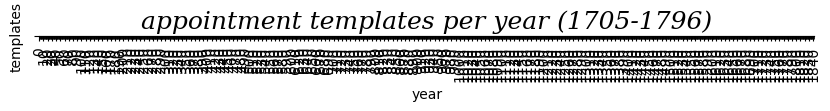

In [1083]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
font = {'family': 'serif',
        'color':  'black',
        'weight': 'normal',
        'style': 'italic',
        'size': 18,
        }

fig = plt.figure(figsize=(10,50))
ax = plt.subplot(aspect=1)
# fig, ax = plt.subplots(1,1)

x = sns.barplot(x='year', data=result, ax=ax) #udts.year.unique(),y=f, ax=ax,color='navy')
tick_spacing = 5
ax.xaxis.set_major_locator(ticker.MultipleLocator(10))
ax.xaxis.set_minor_locator(ticker.MultipleLocator(1))
ax.xaxis.set_minor_formatter(ticker.NullFormatter())
plt.xticks(rotation=90)
x.set_title("appointment templates per year (1705-1796)",fontdict=font)
x.set_ylabel('templates')
plt.show()

AttributeError: 'FacetGrid' object has no attribute 'set_major_locator'

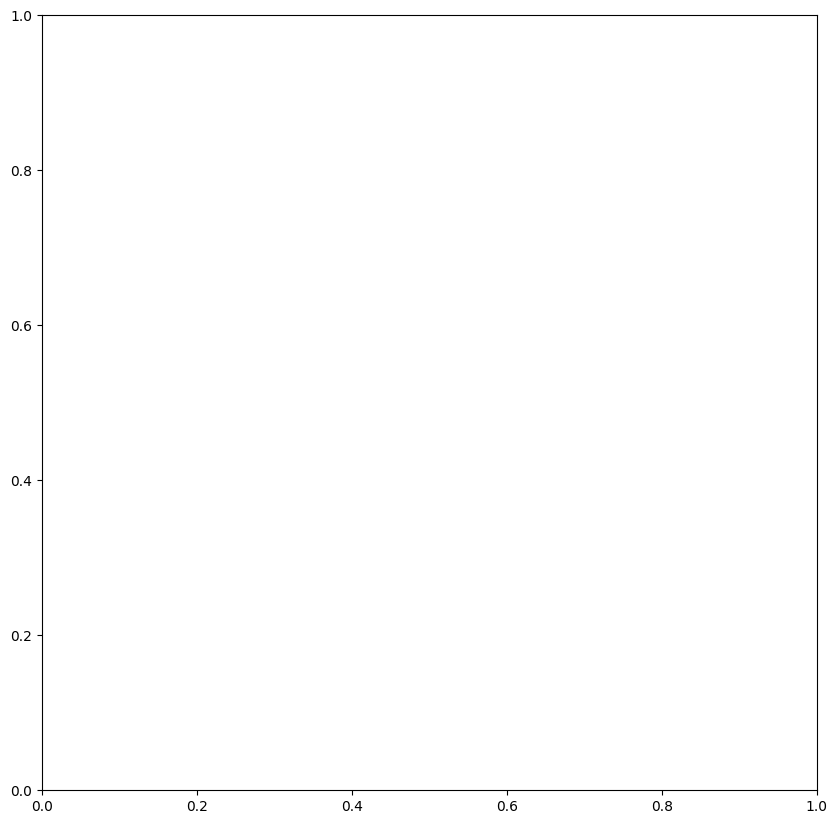

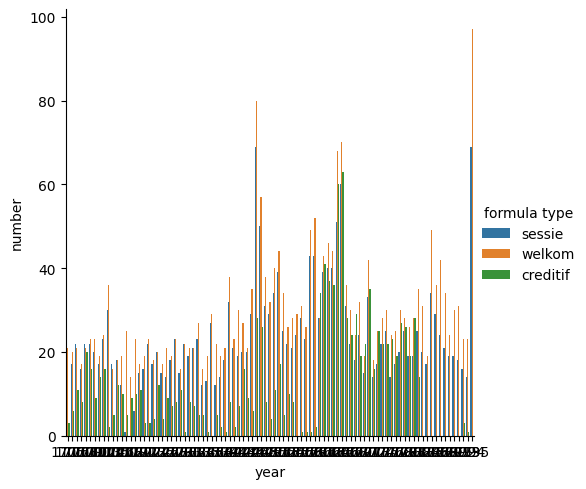

In [1041]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
font = {'family': 'serif',
        'color':  'black',
        'weight': 'normal',
        'style': 'italic',
        'size': 12,
        }

fig = plt.figure(figsize=(10,50))
ax = plt.subplot(aspect=1)
# fig, ax = plt.subplots(1,1)

x = sns.catplot(x='year' ,y='number', hue='formula type', data=meltedresult, kind='bar', ax=ax) #udts.year.unique(),y=f, ax=ax,color='navy')
tick_spacing = 5
x.set_major_locator(ticker.MultipleLocator(tick_spacing))
x.
plt.xticks(rotation=90)
x.set_title("appointment templates per year (1705-1796)",fontdict=font)
x.set_ylabel('templates')
plt.show()

In [1097]:
result.to_csv('./csvs/appointment_templates.csv', sep='\t', index=False)

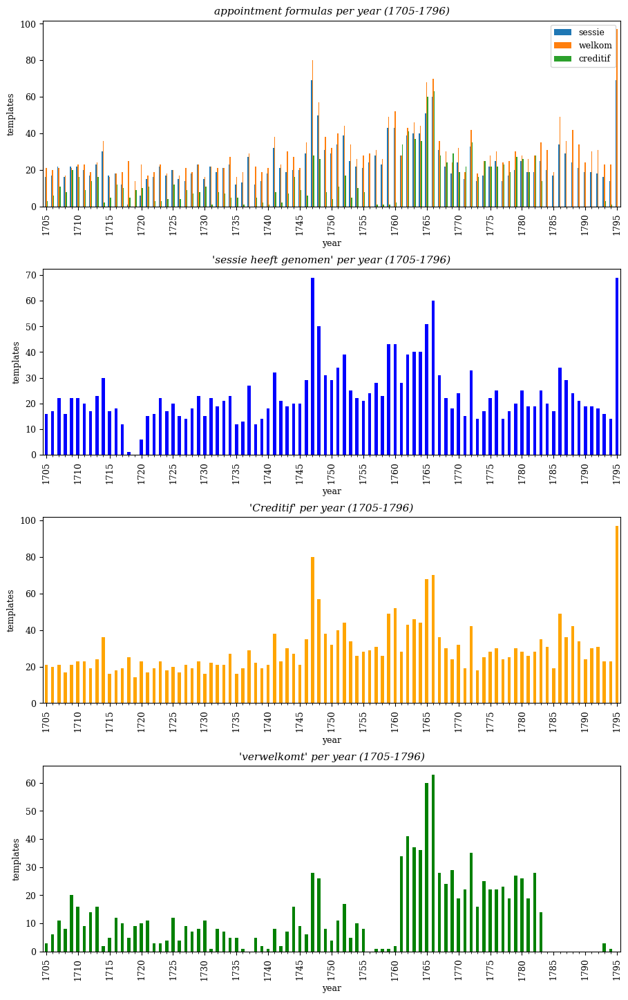

In [1093]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import numpy as np

tick_spacing = 5
font = {'family': 'serif',
        'color':  'black',
        'weight': 'normal',
        'style': 'italic',
        'size': 11,
        }

plt.rcParams.update({'font.size': 9, 'font.family': 'serif',})
fig, (ax1,ax2,ax3,ax4) = plt.subplots(4,1, figsize=(10,15))
fig.tight_layout(pad=5.0)
result.set_index('year').plot.bar(ax=ax1)

ax1.xaxis.set_major_locator(ticker.MultipleLocator(tick_spacing))
ax1.xaxis.set_minor_locator(ticker.MultipleLocator(1))
ax1.xaxis.set_minor_formatter(ticker.NullFormatter())
ax1.set_title("appointment formulas per year (1705-1796)", fontdict=font)
ax1.set_ylabel('templates')

result.set_index('year').sessie.plot.bar(ax=ax2, color='blue')
ax2.xaxis.set_major_locator(ticker.MultipleLocator(tick_spacing))
ax2.xaxis.set_minor_locator(ticker.MultipleLocator(1))
ax2.xaxis.set_minor_formatter(ticker.NullFormatter())
ax2.set_title("'sessie heeft genomen' per year (1705-1796)", fontdict=font)
ax2.set_ylabel('templates')

result.set_index('year').welkom.plot.bar(ax=ax3, color='orange')
ax3.xaxis.set_major_locator(ticker.MultipleLocator(tick_spacing))
ax3.xaxis.set_minor_locator(ticker.MultipleLocator(1))
ax3.xaxis.set_minor_formatter(ticker.NullFormatter())
ax3.set_title("'Creditif' per year (1705-1796)", fontdict=font)
ax3.set_ylabel('templates')

result.set_index('year').creditif.plot.bar(ax=ax4, color='green')
ax4.xaxis.set_major_locator(ticker.MultipleLocator(tick_spacing))
ax4.xaxis.set_minor_locator(ticker.MultipleLocator(1))
ax4.xaxis.set_minor_formatter(ticker.NullFormatter())
ax4.set_title("'verwelkomt' per year (1705-1796)", fontdict=font)
ax4.set_ylabel('templates')

plt.show()

In [1095]:
result.to_csv('/Users/rikhoekstra/surfdrive/Republic/controle/appointment_templates_18thc.csv', sep='\t')

In [813]:
import seaborn as sns

In [770]:
wkm_forms = [(res.id,'\n'.join([p.text for p in res.paragraphs])) for res in resolutions_1757 if res.id in wkmdays]
wkm_frame = pd.DataFrame(wkm_forms)

In [1068]:
wkm_forms[10]

('session-1757-03-31-num-1-resolution-6',
 'ONtfangen een Missive van de Heeren Gedeputeerde Staaten van de Provincie van Vriesland, geschreven te Leeuwaarden den een en twintighsten deeser loopende maand, houdende Creditif op den Heer Georg Sigismund van Hiemstra, als ordinaris Gecommitteerde ter Vergaderinge van haar Hoogh Mogende. WAAR op gedelibereert, en by haar Hoogh Mogende verklaart zynde, dat gemelden Heere wan Hiemstra haar aangenaam was, is den selven verwelkomt , en heeft dienvolgende sessie genoomen.')

In [772]:
group = [e[1] for e in wkm_forms]

In [773]:
from collatex import Collation, collate
from io import StringIO

collation = Collation()
for i in enumerate(group):
        nr = f'{i[0]}'
        witness = i[1]
        witness = re.sub('[<>]','',witness)
    #     witness = ' '.join([re.sub('\W+','',e) for e in list(i[1])])
        collation.add_plain_witness(nr, witness)
alignment_tsv = collate(collation, near_match=True, segmentation=False, output="tsv")
cxresult = pd.read_csv(StringIO(alignment_tsv), sep='\t', header=None).fillna('')


In [1077]:
collate(collation, near_match=True, segmentation=False, output="svg")

KeyboardInterrupt: 

In [1078]:
cxresult.to_excel('~/surfdrive/Republic/controle/output_welkom_1757.xlsx') #,sep='\t')

In [1082]:
print(cxresult[cxresult.columns[-20:]].to_markdown())

|    | 437   | 438         | 439   | 440       | 441   | 442   | 443   | 444   | 445      | 446        | 447   | 448   | 449   | 450    | 451     | 452          | 453   | 454       | 455      | 456   |
|---:|:------|:------------|:------|:----------|:------|:------|:------|:------|:---------|:-----------|:------|:------|:------|:-------|:--------|:-------------|:------|:----------|:---------|:------|
|  0 | van   | Bleyswyck   | haar  | aangenaam | was   | ,     | is    | den   | selve    | verwelkomt |       | ,     | en    | heeft  |         | dienvolgende |       | sessie    | genoomen | .     |
|  1 | van   | Citters     | haar  | aangenaam | was   | ,     | is    | den   | selven   | verwelkomt |       | ,     | en    | heeft  |         | dienvolgende |       | sessie    | genoomen | .     |
|  2 | van   | Lobensels   | haar  | aangenaam | was   | ,     | is    | den   | selven   | verwelkomt |       | ,     | en    | heeft  |         | dienvolgende |       | sessie    | genoomen 

In [733]:
perdate['gaps'] = perdate.be.apply(gaps)

In [736]:
perdate.loc[perdate.gaps.notna()]

,lowphrase,be,gaps
doc_id,,,
session-1757-03-07-num-1-resolution-13,"[was is den selven verwelkomt, is den selven v...","[(59, 6), (60, 5), (61, 4), (62, 3), (63, 2)]",{}
session-1757-03-21-num-1-resolution-6,"[was is den selven verwelkomt, is den selven v...","[(138, 6), (139, 5), (140, 4), (141, 3), (142,...",{}
session-1757-03-30-num-1-resolution-2,"[was is den selven verwelkomt, is den selven v...","[(95, 6), (96, 5), (97, 4), (98, 3), (99, 2)]",{}
session-1757-03-31-num-1-resolution-6,"[was is den selven verwelkomt, is den selven v...","[(59, 6), (60, 5), (61, 4), (62, 3), (63, 2)]",{}
session-1757-04-21-num-1-resolution-4,"[was is den selven verwelkomt, is den selven v...","[(56, 6), (57, 5), (58, 4), (59, 3), (60, 2)]",{}
session-1757-04-26-num-1-resolution-3,"[is den selven verwelkomt en, den selven verwe...","[(40, 53), (41, 52)]",{}
session-1757-05-02-num-1-resolution-10,"[was is den selven verwelkomt, is den selven v...","[(90, 6), (91, 5), (92, 4), (93, 3), (94, 2)]",{}
session-1757-05-02-num-1-resolution-11,"[was is den selven verwelkomt, is den selven v...","[(96, 6), (97, 5), (98, 4), (99, 3), (100, 2)]",{}
session-1757-05-02-num-1-resolution-12,"[was is den selven verwelkomt, is den selven v...","[(56, 156), (57, 155), (58, 154), (59, 153), (...",{}


In [737]:
perdate.gaps.apply(chn)

KeyError: 0

In [734]:
wkm.columns

Index(['phrase', 'doc_id', 'doc_len', 'pos_start', 'rel_pos_start', 'pos_end',
       'rel_pos_end', 'phrase_freq', 'length_bin', 'lcats', 'lowphrase',
       'welkom', 'standard_welkom', 'be'],
      dtype='object')

In [728]:
wkm.apply(lambda row:pd.Series(find_continuation(row, findstring='welkom ')),axis=1)

phrase                       was is den selven verwelkomt
doc_id             session-1757-03-07-num-1-resolution-13
doc_len                                                70
pos_start                                              59
rel_pos_start                                    0.842857
pos_end                                                 6
rel_pos_end                                      0.085714
phrase_freq                                           798
length_bin                                            4.0
lcats                                               small
lowphrase                    was is den selven verwelkomt
welkom                                                1.0
standard_welkom               is den selven verwelkomt en
be                                                (59, 6)
Name: 18066713, dtype: object
phrase                        is den selven verwelkomt en
doc_id             session-1757-03-07-num-1-resolution-13
doc_len                                   

""
18066713
18066714
18066715
18066716
18066717
...
18172979
18172980
18172981
18172982


In [448]:
geen_resolutie = gr.fuzzy_groups('geen resolutie')

In [449]:
geen_resolutie

{'2 waar op geen resolutie': 0,
 'a waar op geen resolutie': 0,
 'aar op geen resolutie is': 0,
 'by waar op geen resolutie': 0,
 'de waar op geen resolutie': 0,
 'een waar op geen resolutie': 0,
 'en waar op geen resolutie': 0,
 'in waar op geen resolutie': 0,
 'is daar op geen resolutie': 0,
 's waar op geen resolutie': 0,
 'stad waar op geen resolutie': 0,
 'waar op geen resolutie is': 0,
 'aangenoomen waar op geen resolutie': 0,
 'advertentie waar op geen resolutie': 0,
 'affaires waar op geen resolutie': 0,
 'commandement waar op geen resolutie': 0,
 'deenemarcken waar op geen resolutie': 0,
 'gehouden waar op geen resolutie': 0,
 'geworden waar op geen resolutie': 0,
 'onderhouden waar op geen resolutie': 0,
 'overgegeeven waar op geen resolutie': 0,
 'overgenoomen waar op geen resolutie': 0,
 'toekoomen waar op geen resolutie': 0,
 'als nogh geen resolutie is': 0,
 'in op geen resolutie is': 0,
 'na op geen resolutie is': 0,
 'advertentie aar op geen resolutie': 0,
 'advertentie

In [60]:
gdgroups = gr.kw2groups('goe[dt]+gevonden')

In [61]:
gdgroups

,doc_id
lowphrase,
1 na voorgaande deliberatie goedgevonden,1
15 goedgevonden en verstaan dat,1
15 na voorgaande deliberatie goedgevonden,12
18 goedgevonden en verstaan dat,2
18 na voorgaande deliberatie goedgevonden,4
...,...
zynde is goedgevonden de gedeputeerden,1
zynde is goedgevonden en verstaan,903
zynde is goedgevonden het selve,1


In [304]:
goed_groupsfuz = gr.fuzzy_groups(keyword='goe[dt]+gevonden')

In [305]:
goed_groupsfuz

{'is naar voorgaande deliberatie goedgevonden': 0,
 'voorgaande deliberatie goedgevonden en sijne': 0,
 'van na voorgaande deliberatie goedgevonden': 0,
 'naar voorgaande deliberatie goedgevonden en': 0,
 'is na voorgaande deliberatie goedgevonden': 0,
 'na voorgaande deliberatie goedtgevonden ende': 0,
 'voorgaande deliberatie goedgevonden en <end>': 0,
 'voorgaande deliberatie goetgevonden ende verstaan': 0,
 '18 na voorgaande deliberatie goedgevonden': 0,
 'jaars na voorgaande deliberatie goedgevonden': 0,
 'na voorgaande deliberatie goetgevonden ende': 0,
 '1 na voorgaande deliberatie goedgevonden': 0,
 'de na voorgaande deliberatie goedgevonden': 0,
 'voorgaande deliberatie goedtgevonden ende verstaan': 0,
 'na voorgaande deliberatie goedgevonden en': 0,
 'na voorgaande deliberatie goedgevonden ende': 0,
 '15 na voorgaande deliberatie goedgevonden': 0,
 'vyftigh voorgaande deliberatie goedgevonden en': 0,
 'is na voorgaande deliberatie goedtgevonden': 0,
 'voorgaande deliberatie g

In [306]:
goed_groupsklus = gr.klustergroups(keyword='goe[dt]+gevonden')

In [307]:
goed_groupsklus[('lowphrase','unique')].to_dict()

{0: array(['dertigh is goedgevonden en geordonneert',
        'is goedgevonden en geordonneert waar'], dtype=object),
 1: array(['doen is goedgevonden en verstaan',
        'geeven is goedgevonden en verstaan',
        'waaren is goedgevonden en verstaan',
        'werden is goedgevonden en verstaan',
        'worden is goedgevonden en verstaan'], dtype=object),
 2: array(['is naar voorgaande deliberatie goedgevonden',
        'na vyftigh voorgaande deliberatie goedgevonden'], dtype=object),
 3: array(['niet was goedgevonden het voorschreeve',
        'was goedgevonden het voorschreeve tweede'], dtype=object),
 4: array(['goedgevonden en verstaan aan gemelde',
        'goedgevonden en verstaan alvoorens in',
        'goedgevonden en verstaan by provisie',
        'goedgevonden en verstaan de gemelde',
        'goedgevonden en verstaan de heeren',
        'goedgevonden en verstaan den fiscaal',
        'goedgevonden en verstaan den gemelden',
        'goedgevonden en verstaan gemelde he

In [308]:
for i in enumerate(goed_groupsklus[('lowphrase','unique')].to_dict().items()):
    print(i[1][1])

['dertigh is goedgevonden en geordonneert'
 'is goedgevonden en geordonneert waar']
['doen is goedgevonden en verstaan' 'geeven is goedgevonden en verstaan'
 'waaren is goedgevonden en verstaan' 'werden is goedgevonden en verstaan'
 'worden is goedgevonden en verstaan']
['is naar voorgaande deliberatie goedgevonden'
 'na vyftigh voorgaande deliberatie goedgevonden']
['niet was goedgevonden het voorschreeve'
 'was goedgevonden het voorschreeve tweede']
['goedgevonden en verstaan aan gemelde'
 'goedgevonden en verstaan alvoorens in'
 'goedgevonden en verstaan by provisie'
 'goedgevonden en verstaan de gemelde'
 'goedgevonden en verstaan de heeren'
 'goedgevonden en verstaan den fiscaal'
 'goedgevonden en verstaan den gemelden'
 'goedgevonden en verstaan gemelde heere'
 'goedgevonden en verstaan haar hoogh']
['haar hoogh mogende goedgevonden hadden']
['ses en vyftigh hadden goedgevonden']
['of gedelibereert zynde is goedgevonden'
 'op gedelibereert zynde is goedgevonden'
 'waar gedelibere

In [309]:
klusgroeps = {e:i[0] for i in enumerate(goed_groupsklus[('lowphrase','unique')].to_dict().items()) for e in i[1][1]}

In [310]:
klusgroeps

{'dertigh is goedgevonden en geordonneert': 0,
 'is goedgevonden en geordonneert waar': 0,
 'doen is goedgevonden en verstaan': 1,
 'geeven is goedgevonden en verstaan': 1,
 'waaren is goedgevonden en verstaan': 1,
 'werden is goedgevonden en verstaan': 1,
 'worden is goedgevonden en verstaan': 1,
 'is naar voorgaande deliberatie goedgevonden': 2,
 'na vyftigh voorgaande deliberatie goedgevonden': 2,
 'niet was goedgevonden het voorschreeve': 3,
 'was goedgevonden het voorschreeve tweede': 3,
 'goedgevonden en verstaan aan gemelde': 4,
 'goedgevonden en verstaan alvoorens in': 4,
 'goedgevonden en verstaan by provisie': 4,
 'goedgevonden en verstaan de gemelde': 4,
 'goedgevonden en verstaan de heeren': 4,
 'goedgevonden en verstaan den fiscaal': 4,
 'goedgevonden en verstaan den gemelden': 4,
 'goedgevonden en verstaan gemelde heere': 4,
 'goedgevonden en verstaan haar hoogh': 4,
 'haar hoogh mogende goedgevonden hadden': 5,
 'ses en vyftigh hadden goedgevonden': 6,
 'of gedelibereert

In [311]:
pd.DataFrame([{'formula':i, 'grk':klusgroeps.get(i) or 1000, 'grf':goed_groupsfuz.get(i) or 2000} for i in klusgroeps]).to_clipboard()

In [314]:
gf = pd.read_clipboard()

In [315]:
gf

,lowphrase,Kolom2,goedgroep
0,deese geleegentheid goedgevonden en verstaan,13,1
1,en is vervolgens goedgevonden en,30,1
2,gebraght heeft is goedgevonden en,34,1
3,gecommuniceert te werden is goedgevonden,35,1
4,geconsenteert en is vervolgens goedgevonden,36,1
...,...,...,...
440,is goedgevonden en verstaan mits,1,100
441,deliberatie goedtgevonden ende verstaan mits,1,100
442,deliberatie goedgevonden ende verstaan mits,1,100
443,zynde is mits deesen goedgevonden,24,100


In [317]:
merged_goedgevonden = pd.merge(left=df1757, right=gf, left_on='lowphrase', right_on='lowphrase')


In [349]:
df1757 = df1757.merge(gf[['lowphrase','goedgroep']], on='lowphrase', how='left')

In [333]:
waarfuzgr = gr.fuzzy_groups(keyword='waar ', contains='start')

In [334]:
waarfuzgr

{'waar aan de permissie tot': 0,
 'waar voor de permissie tot': 0,
 'waar toe het selve is': 1,
 'waar hy den selve aan': 1,
 'waar door de stad van': 1,
 'waar na deselve sigh met': 1,
 'waar van door deselve in': 1,
 'waar over deselve sigh by': 1,
 'waar door de lasten van': 1,
 'waar meede hy heere van': 1,
 'waar van door hem cen': 1,
 'waar toe deselve aan hem': 1,
 'waar omtrent de ordres van': 1,
 'waar van hy heere hop': 1,
 'waar over hy heere d': 1,
 'waar van hy geene de': 1,
 'waar by den selve en': 1,
 'waar by een somme van': 1,
 'waar in deselve in den': 1,
 'waar toe het selve fonds': 1,
 'waar toe het een en': 1,
 'waar in deselve ten tyde': 1,
 'waar toe voor hem te': 1,
 'waar van hy heere de': 1,
 'waar by hy heere van': 1,
 'waar door het gemelde schip': 1,
 'waar meede de judicature van': 1,
 'waar onder het selve schip': 1,
 'waar toe den raad van': 1,
 'waar by het selve aan': 1,
 'waar meede het selve by': 1,
 'waar in deselve alle sijne': 1,
 'waar in door he

In [335]:
waarklusgr = gr.klustergroups(keyword='waar ', contains='start')

In [336]:
wklusgroeps = {e:i[0] for i in enumerate(waarklusgr[('lowphrase','unique')].to_dict().items()) for e in i[1][1]}

In [337]:
wklusgroeps

{'waar by haar hoog mog': 0,
 'waar by haar hoog mogende': 0,
 'waar op by haar hoogh': 0,
 'waar op geen de provincie': 1,
 'waar op geen gevonden en': 1,
 'waar op geen resolutie is': 1,
 'waar van hy heer praesideerende': 2,
 'waar van hy heere ambassadeur': 2,
 'waar van hy heere de': 2,
 'waar van hy heere hop': 2,
 'waar toe deselve aan hem': 3,
 'waar te neemen sal werden': 4,
 'waar te neemen sal worden': 4,
 'waar by verklaart was dat': 5,
 'waar door den suppliant buyten': 6,
 'waar uit voor den suppliant': 6,
 'waar uyt voor den suppliant': 6,
 'waar voor den suppliant de': 6,
 'waar van de collatie tusschen': 7,
 'waar van de equipagie hy': 7,
 'waar van de gevolgen van': 7,
 'waar van de provincie van': 7,
 'waar van de voorgemelde publicatie': 7,
 'waar by de magistraat van': 8,
 'waar door de magistraat van': 8,
 'waar voor door de magistraat': 8,
 'waar toe haar hoogh mogende': 9,
 'waar toe hun hoogh mogende': 9,
 'waar meede de gemelde secretaris': 10,
 'waar meede ge

In [343]:
pd.DataFrame(waarfuzgr, index=[0]).transpose().to_clipboard()

In [342]:
waarfuzgr

{'waar aan de permissie tot': 0,
 'waar voor de permissie tot': 0,
 'waar toe het selve is': 1,
 'waar hy den selve aan': 1,
 'waar door de stad van': 1,
 'waar na deselve sigh met': 1,
 'waar van door deselve in': 1,
 'waar over deselve sigh by': 1,
 'waar door de lasten van': 1,
 'waar meede hy heere van': 1,
 'waar van door hem cen': 1,
 'waar toe deselve aan hem': 1,
 'waar omtrent de ordres van': 1,
 'waar van hy heere hop': 1,
 'waar over hy heere d': 1,
 'waar van hy geene de': 1,
 'waar by den selve en': 1,
 'waar by een somme van': 1,
 'waar in deselve in den': 1,
 'waar toe het selve fonds': 1,
 'waar toe het een en': 1,
 'waar in deselve ten tyde': 1,
 'waar toe voor hem te': 1,
 'waar van hy heere de': 1,
 'waar by hy heere van': 1,
 'waar door het gemelde schip': 1,
 'waar meede de judicature van': 1,
 'waar onder het selve schip': 1,
 'waar toe den raad van': 1,
 'waar by het selve aan': 1,
 'waar meede het selve by': 1,
 'waar in deselve alle sijne': 1,
 'waar in door he

In [339]:
merge_waar = merged_goedgevonden.merge(df1757[['doc_id','waar_fuzzy']], right_on='doc_id',left_on='doc_id')

KeyError: "['waar_fuzzy'] not in index"

In [ ]:
strt = gr.fuzzy_groups('<start>',contains='start')

In [ ]:
strt

{'<start> 15 ter vergaderinge geleesen': 0,
 '<start> 8 ter vergaderinge geleesen': 0,
 '<start> 15 ter vergaderinge geleelen': 0,
 '<start> is ter vergaderinge geleelen': 0,
 '<start> 18 ter vergaderinge geleesen': 0,
 '<start> 8 ter vergaderinge geleelen': 0,
 '<start> is ter vergaderinge geleesen': 0,
 '<start> 185 ter vergaderinge geleesen': 0,
 '<start> s ter vergaderinge geleesen': 0,
 '<start> 18 ter vergaderinge geleelen': 0,
 '<start> is gehoort bet rapport': 1,
 '<start> 18 gehoort het rapport': 1,
 '<start> is gehoort het rapport': 1,
 '<start> by resumtie gedelibereert zynde': 2,
 '<start> de conclusie van versoeck': 3,
 '<start> de conclusie van antwoord': 3,
 '<start> de griffier fagel heeft': 4,
 '<start> de heere d ablaing': 5,
 '<start> den heere d ablaing': 5,
 '<start> de heere van wassenaer': 6,
 '<start> den heere van heyden': 6,
 '<start> de heeren nagel en': 6,
 '<start> de heere de kempenaar': 6,
 '<start> den heere van wassenaer': 6,
 '<start> de heeren van hee

In [ ]:
pd.DataFrame(strt, index=[0]).transpose().to_clipboard()

In [ ]:
strt

{'<start> 15 ter vergaderinge geleesen': 0,
 '<start> 8 ter vergaderinge geleesen': 0,
 '<start> 15 ter vergaderinge geleelen': 0,
 '<start> is ter vergaderinge geleelen': 0,
 '<start> 18 ter vergaderinge geleesen': 0,
 '<start> 8 ter vergaderinge geleelen': 0,
 '<start> is ter vergaderinge geleesen': 0,
 '<start> 185 ter vergaderinge geleesen': 0,
 '<start> s ter vergaderinge geleesen': 0,
 '<start> 18 ter vergaderinge geleelen': 0,
 '<start> is gehoort bet rapport': 1,
 '<start> 18 gehoort het rapport': 1,
 '<start> is gehoort het rapport': 1,
 '<start> by resumtie gedelibereert zynde': 2,
 '<start> de conclusie van versoeck': 3,
 '<start> de conclusie van antwoord': 3,
 '<start> de griffier fagel heeft': 4,
 '<start> de heere d ablaing': 5,
 '<start> den heere d ablaing': 5,
 '<start> de heere van wassenaer': 6,
 '<start> den heere van heyden': 6,
 '<start> de heeren nagel en': 6,
 '<start> de heere de kempenaar': 6,
 '<start> den heere van wassenaer': 6,
 '<start> de heeren van hee

In [344]:
df1757

,phrase,doc_id,doc_len,pos_start,rel_pos_start,pos_end,rel_pos_end,phrase_freq,length_bin,lcats,lowphrase,goedgroep_x,goedgroep_y
0,der voorleede maand is goedgevonden,session-1757-02-08-num-1-resolution-1,255,181,0.709804,69,0.270588,2,6.0,medium,der voorleede maand is goedgevonden,8,8
1,voorleede maand is goedgevonden en,session-1757-02-08-num-1-resolution-1,255,182,0.713725,68,0.266667,2,6.0,medium,voorleede maand is goedgevonden en,8,8
2,maand is goedgevonden en verstaan,session-1757-02-08-num-1-resolution-1,255,183,0.717647,67,0.262745,5,6.0,medium,maand is goedgevonden en verstaan,1,1
3,maand is goedgevonden en verstaan,session-1757-10-26-num-1-resolution-3,548,400,0.729927,143,0.260949,5,6.0,large,maand is goedgevonden en verstaan,1,1
4,is goedgevonden en verstaan dat,session-1757-02-08-num-1-resolution-1,255,184,0.721569,66,0.258824,52804,6.0,medium,is goedgevonden en verstaan dat,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6589,ingebraght IS goedgevonden en verstaan,session-1757-11-14-num-1-resolution-19,6936,131,0.018887,6800,0.980392,3,9.0,verylarge,ingebraght is goedgevonden en verstaan,1,1
6590,heeft goedgevonden het selve Schip,session-1757-11-14-num-1-resolution-19,6936,4876,0.702999,2055,0.296280,1,9.0,verylarge,heeft goedgevonden het selve schip,8,8
6591,goedgevonden het selve Schip wanneer,session-1757-11-14-num-1-resolution-19,6936,4877,0.703143,2054,0.296136,1,9.0,verylarge,goedgevonden het selve schip wanneer,44,44
6592,is goedgevonden en verstaan by,session-1757-11-16-num-1-resolution-6,939,782,0.832801,152,0.161874,175,7.0,large,is goedgevonden en verstaan by,1,1


In [351]:
df1757['start'] = df1757.lowphrase.map(strt)

In [352]:
merge_waar.loc[merge_waar.waar_fuzzy_x.notna()]

,phrase,doc_id,doc_len,pos_start,rel_pos_start,pos_end,rel_pos_end,phrase_freq,length_bin,lcats,lowphrase,waar_fuzzy_x,waar_cluster,goed_kluster,waarphrase,Kolom1,Kolom2,Kolom3,waar_fuzzy_y
952193,Waar gedelibereert zynde is goedgevonden,session-1757-03-01-num-1-resolution-9,216,91,0.421296,120,0.555556,1,5.0,medium,waar gedelibereert zynde is goedgevonden,69.0,15.0,7.0,waar worden op gedelibereert zynde,waar gedelibereert zynde is goedgevonden,40,1,NaN
952194,Waar gedelibereert zynde is goedgevonden,session-1757-03-01-num-1-resolution-9,216,91,0.421296,120,0.555556,1,5.0,medium,waar gedelibereert zynde is goedgevonden,69.0,15.0,7.0,waar worden op gedelibereert zynde,waar gedelibereert zynde is goedgevonden,40,1,NaN
952195,Waar gedelibereert zynde is goedgevonden,session-1757-03-01-num-1-resolution-9,216,91,0.421296,120,0.555556,1,5.0,medium,waar gedelibereert zynde is goedgevonden,69.0,15.0,7.0,waar worden op gedelibereert zynde,waar gedelibereert zynde is goedgevonden,40,1,NaN
952196,Waar gedelibereert zynde is goedgevonden,session-1757-03-01-num-1-resolution-9,216,91,0.421296,120,0.555556,1,5.0,medium,waar gedelibereert zynde is goedgevonden,69.0,15.0,7.0,waar worden op gedelibereert zynde,waar gedelibereert zynde is goedgevonden,40,1,NaN
952197,Waar gedelibereert zynde is goedgevonden,session-1757-03-01-num-1-resolution-9,216,91,0.421296,120,0.555556,1,5.0,medium,waar gedelibereert zynde is goedgevonden,69.0,15.0,7.0,waar worden op gedelibereert zynde,waar gedelibereert zynde is goedgevonden,40,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
952321,Waar gedelibereert zynde is goedgevonden,session-1757-03-01-num-1-resolution-9,216,91,0.421296,120,0.555556,1,5.0,medium,waar gedelibereert zynde is goedgevonden,69.0,15.0,7.0,waar worden op gedelibereert zynde,waar gedelibereert zynde is goedgevonden,40,1,NaN
952322,Waar gedelibereert zynde is goedgevonden,session-1757-03-01-num-1-resolution-9,216,91,0.421296,120,0.555556,1,5.0,medium,waar gedelibereert zynde is goedgevonden,69.0,15.0,7.0,waar worden op gedelibereert zynde,waar gedelibereert zynde is goedgevonden,40,1,NaN
952323,Waar gedelibereert zynde is goedgevonden,session-1757-03-01-num-1-resolution-9,216,91,0.421296,120,0.555556,1,5.0,medium,waar gedelibereert zynde is goedgevonden,69.0,15.0,7.0,waar worden op gedelibereert zynde,waar gedelibereert zynde is goedgevonden,40,1,NaN
952324,Waar gedelibereert zynde is goedgevonden,session-1757-03-01-num-1-resolution-9,216,91,0.421296,120,0.555556,1,5.0,medium,waar gedelibereert zynde is goedgevonden,69.0,15.0,7.0,waar worden op gedelibereert zynde,waar gedelibereert zynde is goedgevonden,40,1,NaN


In [220]:
merge_start = merged_goedgevonden.merge(starts, on='doc_id')

In [353]:
df1757.start.value_counts() #.groupby(['startgroup','doc_id']).agg('count')

12.0    1605
0.0      412
15.0     174
1.0       77
8.0       51
2.0       34
6.0        7
16.0       3
17.0       2
5.0        2
3.0        2
14.0       1
11.0       1
10.0       1
7.0        1
9.0        1
4.0        1
13.0       1
Name: start, dtype: int64

In [535]:
goeddict = {}
for i in df1757.goedgroep.unique():
    ires = df1757.loc[df1757.goedgroep==i].groupby('lowphrase').agg('count')
    if len(ires)>0:
        ndx = ires.idxmax()
        goeddict[i]=ndx.iat[0]

In [536]:
goeddict

{8.0: 'houdende dat goedgevonden hadden ter',
 1.0: 'zynde is goedgevonden en verstaan',
 100.0: 'is goedgevonden en verstaan mits',
 26.0: 'is dien onvermindert goedgevonden en',
 44.0: 'goedgevonden by der selver placaat',
 2.0: 'dat haar hoogh mogende goedgevonden',
 17.0: 'den raad van staate goedgevonden',
 25.0: 'dertigh is goedgevonden en geordonneert',
 53.0: 'goedgevonden en geresolveert dat de',
 99.0: 'voorleeden jaars houdende dat goedgevonden',
 75.0: 'haare koninghlijcke hoogheyd is goedgevonden'}

In [529]:
startdict = {}
for i in df1757.start.unique():
    ires = df1757.loc[df1757.start==i].groupby('lowphrase').agg('count')
    if len(ires)>0:
        ndx = ires.idxmax()
        startdict[i]=ndx.iat[0] #, ires.max()) # df1757.iloc[ndx].lowphrase)

In [530]:
startdict

{12.0: '<start> ontfangen een missive van',
 0.0: '<start> is ter vergaderinge geleesen',
 15.0: '<start> op de requeste van',
 1.0: '<start> is gehoort het rapport',
 8.0: '<start> de heeren gedeputeerden van',
 17.0: '<start> ynde ter vergaderinge getoont',
 2.0: '<start> by resumtie gedelibereert zynde',
 6.0: '<start> de heeren van heeckeren',
 4.0: '<start> de griffier fagel heeft',
 10.0: '<start> de in aanweesende heere',
 9.0: '<start> de heeren ordinaris gedeputeerden',
 5.0: '<start> de heere d ablaing',
 3.0: '<start> de conclusie van antwoord',
 7.0: '<start> de heere pieck van',
 14.0: '<start> jovis den 30 juny',
 11.0: '<start> de n heere de',
 16.0: '<start> op het geproponeerde van',
 13.0: '<start> jovis den 22 december'}

In [77]:
woverview = pd.DataFrame([{'formula':i, 'grk':wklusgroeps.get(i) or 1000, 'grf':waarfuzgr.get(i) or 2000} for i in waarfuzgr])

In [78]:
df1757['waar_fuzzy'] = df1757.lowphrase.map(waarfuzgr)

In [79]:
df1757['waar_cluster'] = df1757.lowphrase.map(wklusgroeps)

In [356]:
df1757.columns

Index(['phrase', 'doc_id', 'doc_len', 'pos_start', 'rel_pos_start', 'pos_end',
       'rel_pos_end', 'phrase_freq', 'length_bin', 'lcats', 'lowphrase',
       'goedgroep', 'start'],
      dtype='object')

In [357]:
doc_clustered = df1757.set_index(['doc_id','goedgroep','start'])


In [368]:
doc_grouped = df1757.groupby(['doc_id','goedgroep','start'])

In [442]:
goedgr = df1757.loc[df1757.goedgroep.notna()][['doc_id','length_bin','goedgroep','lowphrase']]

In [624]:
startgr = df1757.loc[df1757.start.notna()][['doc_id','start','lowphrase']]

In [443]:
merged_gr = pd.merge(goedgr,startgr, left_on='doc_id',right_on='doc_id', how='outer')

In [533]:
merged_gr['standard_start'] = merged_gr.start.map(startdict)

In [537]:
merged_gr['standard_goed'] = merged_gr.goedgroep.map(goeddict)

In [540]:
merged_gr[['standard_start','standard_goed']].drop_duplicates()

,standard_start,standard_goed
0,<start> ontfangen een missive van,houdende dat goedgevonden hadden ter
2,<start> ontfangen een missive van,zynde is goedgevonden en verstaan
5,<start> is ter vergaderinge geleesen,zynde is goedgevonden en verstaan
8,<start> is ter vergaderinge geleesen,is goedgevonden en verstaan mits
11,NaN,zynde is goedgevonden en verstaan
...,...,...
6795,<start> op de requeste van,NaN
6962,<start> by resumtie gedelibereert zynde,NaN
7153,<start> de heeren van heeckeren,NaN
7224,<start> jovis den 30 juny,NaN


In [555]:
merged_gr

,doc_id,length_bin,goedgroep,lowphrase_x,start,lowphrase_y,standard_start,standard_goed
0,session-1757-02-08-num-1-resolution-1,6.0,8.0,der voorleede maand is goedgevonden,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,houdende dat goedgevonden hadden ter
1,session-1757-02-08-num-1-resolution-1,6.0,8.0,voorleede maand is goedgevonden en,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,houdende dat goedgevonden hadden ter
2,session-1757-02-08-num-1-resolution-1,6.0,1.0,maand is goedgevonden en verstaan,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,zynde is goedgevonden en verstaan
3,session-1757-02-08-num-1-resolution-1,6.0,1.0,is goedgevonden en verstaan dat,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,zynde is goedgevonden en verstaan
4,session-1757-02-08-num-1-resolution-1,6.0,1.0,goedgevonden en verstaan dat copie,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,zynde is goedgevonden en verstaan
...,...,...,...,...,...,...,...,...
7833,session-1757-12-19-num-1-resolution-9,NaN,NaN,NaN,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,NaN
7834,session-1757-12-19-num-1-resolution-10,NaN,NaN,NaN,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,NaN
7835,session-1757-12-19-num-1-resolution-11,NaN,NaN,NaN,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,NaN
7836,session-1757-12-19-num-1-resolution-12,NaN,NaN,NaN,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,NaN


In [541]:
grdict = {}
for i in df1757.geenresolutie.unique():
    ires = df1757.loc[df1757.geenresolutie==i].groupby('lowphrase').agg('count')
    if len(ires)>0:
        ndx = ires.idxmax()
        grdict[i]=ndx.iat[0]

In [456]:
df1757['geenresolutie'] = df1757.lowphrase.map(geen_resolutie)

In [457]:
geenrgr = df1757.loc[df1757.geenresolutie.notna()][['doc_id','geenresolutie','lowphrase']]

In [556]:
merged_gr

,doc_id,length_bin,goedgroep,lowphrase_x,start,lowphrase_y,standard_start,standard_goed
0,session-1757-02-08-num-1-resolution-1,6.0,8.0,der voorleede maand is goedgevonden,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,houdende dat goedgevonden hadden ter
1,session-1757-02-08-num-1-resolution-1,6.0,8.0,voorleede maand is goedgevonden en,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,houdende dat goedgevonden hadden ter
2,session-1757-02-08-num-1-resolution-1,6.0,1.0,maand is goedgevonden en verstaan,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,zynde is goedgevonden en verstaan
3,session-1757-02-08-num-1-resolution-1,6.0,1.0,is goedgevonden en verstaan dat,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,zynde is goedgevonden en verstaan
4,session-1757-02-08-num-1-resolution-1,6.0,1.0,goedgevonden en verstaan dat copie,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,zynde is goedgevonden en verstaan
...,...,...,...,...,...,...,...,...
7833,session-1757-12-19-num-1-resolution-9,NaN,NaN,NaN,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,NaN
7834,session-1757-12-19-num-1-resolution-10,NaN,NaN,NaN,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,NaN
7835,session-1757-12-19-num-1-resolution-11,NaN,NaN,NaN,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,NaN
7836,session-1757-12-19-num-1-resolution-12,NaN,NaN,NaN,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,NaN


In [557]:
merged_geenr = merged_gr.merge(right=geenrgr, on='doc_id',how='outer')

In [558]:
merged_geenr.loc[merged_geenr.geenresolutie.notna()][['doc_id','lowphrase_y','lowphrase_x','lowphrase']].to_clipboard()

In [559]:
merged_geenr['standard_geenres']=merged_geenr.geenresolutie.map(grdict)

In [560]:
merged_geenr

,doc_id,length_bin,goedgroep,lowphrase_x,start,lowphrase_y,standard_start,standard_goed,geenresolutie,lowphrase,standard_geenres
0,session-1757-02-08-num-1-resolution-1,6.0,8.0,der voorleede maand is goedgevonden,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,houdende dat goedgevonden hadden ter,NaN,NaN,NaN
1,session-1757-02-08-num-1-resolution-1,6.0,8.0,voorleede maand is goedgevonden en,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,houdende dat goedgevonden hadden ter,NaN,NaN,NaN
2,session-1757-02-08-num-1-resolution-1,6.0,1.0,maand is goedgevonden en verstaan,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,zynde is goedgevonden en verstaan,NaN,NaN,NaN
3,session-1757-02-08-num-1-resolution-1,6.0,1.0,is goedgevonden en verstaan dat,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,zynde is goedgevonden en verstaan,NaN,NaN,NaN
4,session-1757-02-08-num-1-resolution-1,6.0,1.0,goedgevonden en verstaan dat copie,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,zynde is goedgevonden en verstaan,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
10728,session-1757-11-14-num-1-resolution-9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,geen resolutie is gevallen <end>,op geen resolutie is gevallen
10729,session-1757-12-19-num-1-resolution-6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,advertentie waar op geen resolutie,waar op geen resolutie is
10730,session-1757-12-19-num-1-resolution-6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,waar op geen resolutie is,waar op geen resolutie is
10731,session-1757-12-19-num-1-resolution-6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,op geen resolutie is gevallen,op geen resolutie is gevallen


In [471]:
df1757['waar'] = df1757.lowphrase.map(waarfuzgr)

In [483]:
waar_gr = df1757.loc[df1757.waar.notna()][['doc_id','waar','length_bin','lowphrase']]

In [546]:
waardict = {}
for i in df1757.waar.unique():
    ires = df1757.loc[df1757.waar==i].groupby('lowphrase').agg('count')
    if len(ires)>0:
        ndx = ires.idxmax()
        waardict[i]=ndx.iat[0]

In [561]:
merged_geer_waar = merged_geenr.merge(waar_gr, on='doc_id',how='outer', suffixes=('_xy','_z'))

In [562]:
merged_geer_waar['standard_waar'] = merged_geer_waar.waar.map(waardict)

In [563]:
merged_geer_waar

,doc_id,length_bin_xy,goedgroep,lowphrase_x,start,lowphrase_y,standard_start,standard_goed,geenresolutie,lowphrase_xy,standard_geenres,waar,length_bin_z,lowphrase_z,standard_waar
0,session-1757-02-08-num-1-resolution-1,6.0,8.0,der voorleede maand is goedgevonden,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,houdende dat goedgevonden hadden ter,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,session-1757-02-08-num-1-resolution-1,6.0,8.0,voorleede maand is goedgevonden en,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,houdende dat goedgevonden hadden ter,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,session-1757-02-08-num-1-resolution-1,6.0,1.0,maand is goedgevonden en verstaan,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,zynde is goedgevonden en verstaan,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,session-1757-02-08-num-1-resolution-1,6.0,1.0,is goedgevonden en verstaan dat,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,zynde is goedgevonden en verstaan,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,session-1757-02-08-num-1-resolution-1,6.0,1.0,goedgevonden en verstaan dat copie,12.0,<start> ontfangen een missive van,<start> ontfangen een missive van,zynde is goedgevonden en verstaan,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14262,session-1757-10-11-num-1-resolution-7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,114.0,5.0,waar op gedelibereert zynde hebben,waar op gedelibereert zynde is
14263,session-1757-11-02-num-1-resolution-6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,114.0,7.0,waar op gedelibereert zynde hebben,waar op gedelibereert zynde is
14264,session-1757-10-03-num-1-resolution-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,114.0,6.0,waar op gedelibereert zynde hebben,waar op gedelibereert zynde is
14265,session-1757-10-03-num-1-resolution-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,114.0,6.0,waar op gedelibereert zynde hebben,waar op gedelibereert zynde is


In [580]:
merged_geer_waar.rename(columns={'lowphrase_x':'goedgevonden_variant',
                                 'lowphrase_y':'start_variant',
                                 'lowphrase_xy':'geen_resolutie_variant',
                                 'lowphrase_z':'waar_variant'},inplace='True')

In [581]:
merged_geer_waar.groupby(['start_variant','goedgevonden_variant','geen_resolutie_variant']).doc_id.agg('count')

start_variant                        goedgevonden_variant                          geen_resolutie_variant               
<start> de heeren gedeputeerden van  deliberatie goedgevonden en verstaan dat      geen resolutie is gevallen <end>         1
                                                                                   op geen resolutie is gevallen            1
                                                                                   waar op geen resolutie is                1
                                     goedgevonden en verstaan dat sal              geen resolutie is gevallen <end>         1
                                                                                   op geen resolutie is gevallen            1
                                                                                                                           ..
<start> op de requeste van           van na voorgaande deliberatie goedgevonden    reyse na op geen resolutie              

In [583]:
with pd.option_context('display.max_rows', 1000):
    display(merged_geer_waar.groupby(['start_variant', 'geen_resolutie_variant']).doc_id.agg('count'))

start_variant                         geen_resolutie_variant                  
<start> 15 ter vergaderinge geleesen  daar op verder geen resolutie                  1
                                      geen resolutie gevallen sullende extract       1
                                      op verder geen resolutie gevallen              1
                                      verder geen resolutie gevallen sullende        1
<start> 18 ter vergaderinge geleesen  gedestineert waar op geen resolutie            1
                                      geen resolutie is gevallen <end>               3
                                      op geen resolutie is gevallen                  3
                                      waar op geen resolutie is                      3
<start> de heeren gedeputeerden van   geen resolutie is gevallen <end>               5
                                      op geen resolutie is gevallen                  4
                                      waar op geen 

In [585]:
ggtemplates = merged_geer_waar.groupby(['standard_start','standard_waar', 'standard_goed'])[['doc_id','start_variant','goedgevonden_variant']] # .agg('count').drop_duplicates() #.to_csv('~/Downloads/goedgevonden1757.csv', sep='\t')

In [603]:
ggtemplates.agg({'doc_id':'count', 'start_variant':lambda x: tuple(x),
                 'goedgevonden_variant':lambda x: tuple(x)}).drop_duplicates()

doc_id  \
standard_start                          standard_waar                        standard_goed                                  
<start> by resumtie gedelibereert zynde waar by aan haar hoogh               goedgevonden by der selver placaat         1   
                                                                             houdende dat goedgevonden hadden ter       3   
                                                                             zynde is goedgevonden en verstaan          8   
                                        waar by deselve hebben voorgedraagen zynde is goedgevonden en verstaan          5   
                                        waar by deselve om geallegeerde      houdende dat goedgevonden hadden ter       1   
...                                                                                                                   ...   
<start> op de requeste van              waar op den agent van                zynde is goedgevonden en verstaan         21   
                                        waar op gedelibereert zynde is       houdende dat goedgevonden hadden ter       4   
                                                                             is goedgevonden en verstaan mits           1   
                                                                             zynde is goedgevonden en verstaan         37   
                                        waar van een genaamt cornelis        zynde is goedgevonden en verstaan          4   

                                                                                                                                                       start_variant  \
standard_start                          standard_waar                        standard_goed                                                                             
<start> by resumtie gedelibereert zynde waar by aan haar hoogh               goedgevonden by der selver placaat           (<start> by resumtie gedelibereert zynde,)   
                                                                             houdende dat goedgevonden hadden ter  (<start> by resumtie gedelibereert zynde, <sta...   
                                                                             zynde is goedgevonden en verstaan     (<start> by resumtie gedelibereert zynde, <sta...   
                                        waar by deselve hebben voorgedraagen zynde is goedgevonden en verstaan     (<start> by resumtie gedelibereert zynde, <sta...   
                                        waar by deselve om geallegeerde      houdende dat goedgevonden hadden ter         (<start> by resumtie gedelibereert zynde,)   
...                                                                                                                                                              ...   
<start> op de requeste van              waar op den agent van                zynde is goedgevonden en verstaan     (<start> op de memorie van, <start> op de memo...   
                                        waar op gedelibereert zynde is       houdende dat goedgevonden hadden ter  (<start> op de memorie van, <start> op de memo...   
                                                                             is goedgevonden en verstaan mits                           (<start> op de memorie van,)   
                                                                             zynde is goedgevonden en verstaan     (<start> op de memorie van, <start> op de memo...   
                                        waar van een genaamt cornelis        zynde is goedgevonden en verstaan     (<start> op de requeste van, <start> op de req...   

                                                                                                                                                goedgevonden_variant  
standard_start                          standard_waar                        standard_goed                                               

In [614]:
df1757.columns

Index(['phrase', 'doc_id', 'doc_len', 'pos_start', 'rel_pos_start', 'pos_end',
       'rel_pos_end', 'phrase_freq', 'length_bin', 'lcats', 'lowphrase',
       'goedgroep', 'start', 'be', 'geenresolutie', 'waar'],
      dtype='object')

In [622]:
def dictgroep(kw, df):
    kwdict = {}
    for i in df[kw].unique():
        ires = df.loc[df1757.waar==i].groupby('lowphrase').agg('count')
        if len(ires)>0:
            ndx = ires.idxmax()
            kwdict[i]=ndx.iat[0]
    return kwdict

In [621]:
gr.fuzzy_groups(keyword='welkom')

{'den selve verwelkomt en heeft': 0,
 'den selven verwelkomt en heeft': 0,
 'is den selven verwelkomt en': 1,
 'is den selve verwelkomt en': 1,
 'was is den selve verwelkomt': 1,
 'was is den selven verwelkomt': 1,
 'selve verwelkomt en heeft dienvolgende': 2,
 'selven verwelkomt en heeft dienvolgende': 2,
 'verwelkomt en heeft dienvolgende sessie': 3}

In [623]:
dictgroep('welkom', df1757)

KeyError: 'welkom'

In [619]:
df1757.loc[(df1757.start.isna() )& (df1757.pos_start==1) & ~(df1757.doc_id.str.contains('attendance'))].lowphrase

1            ontfangen een missive van den
129          ontfangen een missive van den
372           ontfangen een missive van de
502        is ter vergaderinge geleesen de
634          ontfangen een missive van den
                        ...               
249905       ontfangen een missive van den
250036        ontfangen een missive van de
250113    is ter vergaderinge geleesen een
250181     is ter vergaderinge geleesen de
250425     is ter vergaderinge geleesen de
Name: lowphrase, Length: 2277, dtype: object

In [504]:
merged_geer_waar.goedgroep.unique()

array([  8.,   1., 100.,  26.,  44.,   2.,  17.,  25.,  53.,  99.,  75.,
        nan])

In [ ]:
for:
df1757['lowphrase','unique'][i]).max().iat[0]].index.values[0]

In [445]:
merged_gr.groupby(['doc_id','start', 'goedgroep']).agg('count')

length_bin  \
doc_id                                 start goedgroep               
session-1757-01-03-num-1-resolution-12 0.0   1.0                 5   
session-1757-01-03-num-1-resolution-19 15.0  1.0                 4   
                                             100.0               1   
session-1757-01-03-num-1-resolution-20 15.0  1.0                 4   
                                             100.0               1   
...                                                            ...   
session-1757-12-29-num-1-resolution-5  12.0  1.0                 5   
session-1757-12-30-num-1-resolution-2  12.0  26.0                2   
session-1757-12-30-num-1-resolution-3  12.0  1.0                 4   
                                             100.0               1   
session-1757-12-30-num-1-resolution-4  0.0   1.0                 5   

                                                        lowphrase_x  \
doc_id                                 start goedgroep                
session-1757-01-03-num-1-resolution-12 0.0   1.0                  5   
session-1757-01-03-num-1-resolution-19 15.0  1.0                  4   
                                             100.0                1   
session-1757-01-03-num-1-resolution-20 15.0  1.0                  4   
                                             100.0                1   
...                                                             ...   
session-1757-12-29-num-1-resolution-5  12.0  1.0                  5   
session-1757-12-30-num-1-resolution-2  12.0  26.0                 2   
session-1757-12-30-num-1-resolution-3  12.0  1.0                  4   
                                             100.0                1   
session-1757-12-30-num-1-resolution-4  0.0   1.0                  5   

                                                        lowphrase_y  
doc_id                                 start goedgroep               
session-1757-01-03-num-1-resolution-12 0.0   1.0                  5  
session-1757-01-03-num-1-resolution-19 15.0  1.0                  4  
                                             100.0                1  
session-1757-01-03-num-1-resolution-20 15.0  1.0                  4  
                                             100.0                1  
...                                                             ...  
session-1757-12-29-num-1-resolution-5  12.0  1.0                  5  
session-1757-12-30-num-1-resolution-2  12.0  26.0                 2  
session-1757-12-30-num-1-resolution-3  12.0  1.0                  4  
                                             100.0                1  
session-1757-12-30-num-1-resolution-4  0.0   1.0                  5  

[1465 rows x 3 columns]

In [469]:
df1757[df1757.doc_id=='session-1757-05-31-num-1-resolution-8']

,phrase,doc_id,doc_len,pos_start,rel_pos_start,pos_end,rel_pos_end,phrase_freq,length_bin,lcats,lowphrase,goedgroep,start,be,geenresolutie
119692,van den Heere Graave van,session-1757-05-31-num-1-resolution-8,46,4,0.086957,37,0.804348,2002,4.0,NaN,van den heere graave van,NaN,NaN,"(4, 37)",NaN
119693,haar Hoogh Mogende extraordinaris Envoyé,session-1757-05-31-num-1-resolution-8,46,10,0.217391,31,0.673913,13208,4.0,NaN,haar hoogh mogende extraordinaris envoyé,NaN,NaN,"(10, 31)",NaN
119694,Hoogh Mogende extraordinaris Envoyé en,session-1757-05-31-num-1-resolution-8,46,11,0.239130,30,0.652174,1547,4.0,NaN,hoogh mogende extraordinaris envoyé en,NaN,NaN,"(11, 30)",NaN
119695,Mogende extraordinaris Envoyé en Plenipotentiaris,session-1757-05-31-num-1-resolution-8,46,12,0.260870,29,0.630435,2309,4.0,NaN,mogende extraordinaris envoyé en plenipotentiaris,NaN,NaN,"(12, 29)",NaN
119696,extraordinaris Envoyé en Plenipotentiaris aan,session-1757-05-31-num-1-resolution-8,46,13,0.282609,28,0.608696,6417,4.0,NaN,extraordinaris envoyé en plenipotentiaris aan,NaN,NaN,"(13, 28)",NaN
119697,Envoyé en Plenipotentiaris aan het,session-1757-05-31-num-1-resolution-8,46,14,0.304348,27,0.586957,6647,4.0,NaN,envoyé en plenipotentiaris aan het,NaN,NaN,"(14, 27)",NaN
119698,en Plenipotentiaris aan het Hof,session-1757-05-31-num-1-resolution-8,46,15,0.326087,26,0.565217,7108,4.0,NaN,en plenipotentiaris aan het hof,NaN,NaN,"(15, 26)",NaN
119699,Plenipotentiaris aan het Hof van,session-1757-05-31-num-1-resolution-8,46,16,0.347826,25,0.543478,8203,4.0,NaN,plenipotentiaris aan het hof van,NaN,NaN,"(16, 25)",NaN
119700,aan het Hof van sijne,session-1757-05-31-num-1-resolution-8,46,17,0.369565,24,0.521739,25659,4.0,NaN,aan het hof van sijne,NaN,NaN,"(17, 24)",NaN
119701,het Hof van sijne Majesteyt,session-1757-05-31-num-1-resolution-8,46,18,0.391304,23,0.500000,16848,4.0,NaN,het hof van sijne majesteyt,NaN,NaN,"(18, 23)",NaN


In [418]:
pd.pivot_table(df1757,columns=['doc_id'], values=['start','goedgroep'], aggfunc=lambda x: x_if_notna(x))

doc_id,session-1757-01-03-num-1-attendance_list,session-1757-01-03-num-1-resolution-1,session-1757-01-03-num-1-resolution-10,session-1757-01-03-num-1-resolution-11,session-1757-01-03-num-1-resolution-12,session-1757-01-03-num-1-resolution-13,session-1757-01-03-num-1-resolution-14,session-1757-01-03-num-1-resolution-15,session-1757-01-03-num-1-resolution-16,session-1757-01-03-num-1-resolution-17,...,session-1757-12-29-num-1-resolution-2,session-1757-12-29-num-1-resolution-3,session-1757-12-29-num-1-resolution-4,session-1757-12-29-num-1-resolution-5,session-1757-12-30-num-1-attendance_list,session-1757-12-30-num-1-resolution-1,session-1757-12-30-num-1-resolution-2,session-1757-12-30-num-1-resolution-3,session-1757-12-30-num-1-resolution-4,session-1757-12-30-num-1-resolution-5
goedgroep,"[[nan, nan, nan]]","[[nan, nan, nan, nan]]","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan]]","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...",...,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, 1.0, 1.0,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,..."
start,"[[nan, nan, nan]]","[[nan, nan, nan, nan]]","[[12.0, nan, nan, nan, nan, nan, nan, nan, nan...","[[12.0, nan, nan, nan, nan, nan, nan, nan, nan...","[[0.0, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan]]","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...",...,"[[12.0, nan, nan, nan, nan, nan, nan, nan, nan...","[[15.0, nan, nan, nan, nan, nan, nan, nan, nan...","[[12.0, nan, nan, nan, nan, nan, nan, nan, nan...","[[12.0, nan, nan, nan, nan, nan, nan, nan, nan...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[12.0, nan, nan, nan, nan, nan, nan, nan, nan...","[[12.0, nan, nan, nan, nan, nan, nan, nan, nan...","[[12.0, nan, nan, nan, nan, nan, nan, nan, nan...","[[0.0, nan, nan, nan, nan, nan, nan, nan, nan,...","[[1.0, nan, nan, nan, nan, nan, nan, nan, nan,..."


In [411]:
df1757.loc[df1757.doc_id=='session-1757-01-03-num-1-resolution-15']

,phrase,doc_id,doc_len,pos_start,rel_pos_start,pos_end,rel_pos_end,phrase_freq,length_bin,lcats,lowphrase,goedgroep,start,be
41703,ter Vergaderinge getoont en geexhibeert,session-1757-01-03-num-1-resolution-15,23,3,0.130435,15,0.652174,768,3.0,NaN,ter vergaderinge getoont en geexhibeert,NaN,NaN,"(3, 15)"
41704,Vergaderinge getoont en geexhibeert de,session-1757-01-03-num-1-resolution-15,23,4,0.173913,14,0.608696,756,3.0,NaN,vergaderinge getoont en geexhibeert de,NaN,NaN,"(4, 14)"
41705,van den Agent van haar,session-1757-01-03-num-1-resolution-15,23,10,0.434783,8,0.347826,67,3.0,NaN,van den agent van haar,NaN,NaN,"(10, 8)"
41706,den Agent van haar Hoog,session-1757-01-03-num-1-resolution-15,23,11,0.478261,7,0.304348,36,3.0,NaN,den agent van haar hoog,NaN,NaN,"(11, 7)"
41707,Agent van haar Hoog Mogende,session-1757-01-03-num-1-resolution-15,23,12,0.521739,6,0.260870,35,3.0,NaN,agent van haar hoog mogende,NaN,NaN,"(12, 6)"
41708,van haar Hoog Mogende is,session-1757-01-03-num-1-resolution-15,23,13,0.565217,5,0.217391,29,3.0,NaN,van haar hoog mogende is,NaN,NaN,"(13, 5)"


In [367]:
doc_clustered[doc_clustered.index.get_level_values(2).notna()]

,,,phrase,doc_len,pos_start,rel_pos_start,pos_end,rel_pos_end,phrase_freq,length_bin,lcats,lowphrase
doc_id,goedgroep,start,,,,,,,,,,
session-1757-02-07-num-1-resolution-11,NaN,12.0,<START> ONtfangen een Missive van,257,0,0.0,252,0.980545,122917,6.0,medium,<start> ontfangen een missive van
session-1757-02-07-num-1-resolution-12,NaN,12.0,<START> ONtfangen een Missive van,493,0,0.0,488,0.989858,122917,6.0,medium,<start> ontfangen een missive van
session-1757-02-08-num-1-resolution-1,NaN,12.0,<START> ONtfangen een Missive van,255,0,0.0,250,0.980392,122917,6.0,medium,<start> ontfangen een missive van
session-1757-02-08-num-1-resolution-4,NaN,0.0,<START> IS ter Vergaderinge geleesen,110,0,0.0,105,0.954545,17339,5.0,medium,<start> is ter vergaderinge geleesen
session-1757-02-09-num-1-resolution-1,NaN,12.0,<START> ONtfangen een Missive van,41,0,0.0,36,0.878049,122917,4.0,NaN,<start> ontfangen een missive van
...,...,...,...,...,...,...,...,...,...,...,...,...
session-1757-12-19-num-1-resolution-13,NaN,12.0,<START> ONtfangen een Missive van,266,0,0.0,261,0.981203,122917,6.0,medium,<start> ontfangen een missive van
session-1757-12-19-num-1-resolution-14,NaN,12.0,<START> ONtfangen een Missive van,162,0,0.0,157,0.969136,122917,5.0,medium,<start> ontfangen een missive van
session-1757-12-19-num-1-resolution-15,NaN,0.0,<START> IS ter Vergaderinge geleesen,260,0,0.0,255,0.980769,17339,6.0,medium,<start> is ter vergaderinge geleesen


In [173]:
klusgroeps['maand is goedgevonden en verstaan']

143

In [182]:
goed_groupsfuz

{'is naar voorgaande deliberatie goedgevonden': 0,
 'voorgaande deliberatie goedgevonden en sijne': 0,
 'van na voorgaande deliberatie goedgevonden': 0,
 'naar voorgaande deliberatie goedgevonden en': 0,
 'is na voorgaande deliberatie goedgevonden': 0,
 'na voorgaande deliberatie goedtgevonden ende': 0,
 'voorgaande deliberatie goedgevonden en <end>': 0,
 'voorgaande deliberatie goetgevonden ende verstaan': 0,
 '18 na voorgaande deliberatie goedgevonden': 0,
 'jaars na voorgaande deliberatie goedgevonden': 0,
 'na voorgaande deliberatie goetgevonden ende': 0,
 '1 na voorgaande deliberatie goedgevonden': 0,
 'de na voorgaande deliberatie goedgevonden': 0,
 'voorgaande deliberatie goedtgevonden ende verstaan': 0,
 'na voorgaande deliberatie goedgevonden en': 0,
 'na voorgaande deliberatie goedgevonden ende': 0,
 '15 na voorgaande deliberatie goedgevonden': 0,
 'vyftigh voorgaande deliberatie goedgevonden en': 0,
 'is na voorgaande deliberatie goedtgevonden': 0,
 'voorgaande deliberatie g

In [186]:
pd.DataFrame(goed_groupsfuz, index=[0]).transpose().to_clipboard()

In [164]:
doc_clustered.loc[ (doc_clustered.goed_kluster.notna())]

,phrase,doc_len,pos_start,rel_pos_start,pos_end,rel_pos_end,phrase_freq,length_bin,lcats,lowphrase,waar_fuzzy,waar_cluster,goed_kluster,waarphrase
doc_id,,,,,,,,,,,,,,
session-1757-02-08-num-1-resolution-1,der voorleede maand is goedgevonden,255,181,0.709804,69,0.270588,2,6.0,medium,der voorleede maand is goedgevonden,NaN,NaN,50.0,NaN
session-1757-02-08-num-1-resolution-1,voorleede maand is goedgevonden en,255,182,0.713725,68,0.266667,2,6.0,medium,voorleede maand is goedgevonden en,NaN,NaN,87.0,NaN
session-1757-02-08-num-1-resolution-1,maand is goedgevonden en verstaan,255,183,0.717647,67,0.262745,5,6.0,medium,maand is goedgevonden en verstaan,NaN,NaN,143.0,NaN
session-1757-02-08-num-1-resolution-1,is goedgevonden en verstaan dat,255,184,0.721569,66,0.258824,52804,6.0,medium,is goedgevonden en verstaan dat,NaN,NaN,18.0,NaN
session-1757-02-08-num-1-resolution-1,goedgevonden en verstaan dat Copie,255,185,0.725490,65,0.254902,29126,6.0,medium,goedgevonden en verstaan dat copie,NaN,NaN,170.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
session-1757-12-19-num-1-resolution-16,op gedelibereert zynde is goedgevonden,668,599,0.896707,64,0.095808,66393,7.0,large,op gedelibereert zynde is goedgevonden,NaN,NaN,7.0,NaN
session-1757-12-19-num-1-resolution-16,gedelibereert zynde is goedgevonden en,668,600,0.898204,63,0.094311,62939,7.0,large,gedelibereert zynde is goedgevonden en,NaN,NaN,130.0,NaN
session-1757-12-19-num-1-resolution-16,zynde is goedgevonden en verstaan,668,601,0.899701,62,0.092814,64660,7.0,large,zynde is goedgevonden en verstaan,NaN,NaN,143.0,NaN


In [81]:
df1757['goed_kluster'] = df1757.lowphrase.map(klusgroeps)

In [109]:
waar_leg = df1757.groupby('waar_cluster').lowphrase.agg('max').to_dict()

In [111]:
df1757['waarphrase']=df1757.waar_cluster.map(waar_leg)

In [113]:
waardocs = df1757.loc[df1757.waarphrase.notna()].doc_id.unique()

In [119]:
waarloos = df1757.loc[~df1757.doc_id.isin(waardocs)].doc_id.unique()

In [122]:
len(df1757.doc_id.unique())

2919

In [120]:
len(waardocs)

1923

In [121]:
len(waarloos)

996

so this means in 1757 there were in total 2919 unique resolutions, 1923 of which had a phrase starting with 'waar' and 996 lacked such a phrase.

In [124]:
wd = df1757.loc[df1757.doc_id.isin(waardocs)]

In [126]:
goed_leg = df1757.groupby('goed_kluster').lowphrase.agg('max').to_dict()

In [127]:
goed_leg

{0.0: 'is goedgevonden en geordonneert waar',
 1.0: 'worden is goedgevonden en verstaan',
 2.0: 'na vyftigh voorgaande deliberatie goedgevonden',
 3.0: 'was goedgevonden het voorschreeve tweede',
 4.0: 'goedgevonden en verstaan haar hoogh',
 5.0: 'haar hoogh mogende goedgevonden hadden',
 6.0: 'ses en vyftigh hadden goedgevonden',
 7.0: 'waar gedelibereert zynde is goedgevonden',
 8.0: 'gecommuniceert te werden is goedgevonden',
 9.0: 'te werden is goedgevonden en',
 10.0: 'goedgevonden hebben by de voorschreeve',
 11.0: 'goedgevonden en verstaan dat voor',
 12.0: 'goedgevonden hadden ter vergaderinge van',
 13.0: 'vyftigh houdende dat goedgevonden hadden',
 14.0: 'is dien onverhindert goedgevonden en',
 15.0: 'dey van algiers goedgevonden heeft',
 16.0: 'goedgevonden ende verstaan mits deesen',
 17.0: 'hoog mogende vervolgens hebben goedgevonden',
 18.0: 'zyn is goedgevonden en verstaan',
 19.0: 'te herstellen is goedgevonden en',
 20.0: 'te sien maar goedgevonden door',
 21.0: 'van s

In [135]:
w34d = df1757.loc[(df1757['waar_cluster']==34)].doc_id.unique()
#.groupby('goed_kluster').phrase.agg('count') # & (df1757.goed_kluster.notna())]

In [138]:
df1757.loc[df1757.doc_id.isin(w34d)].groupby('goed_kluster').phrase.agg('count').sort_values(ascending=False)

goed_kluster
143.0    885
7.0      774
130.0    767
18.0     629
170.0    344
        ... 
141.0      1
24.0       1
145.0      1
23.0       1
101.0      1
Name: phrase, Length: 122, dtype: int64

In [142]:
gw1 = df1757.loc[(df1757.doc_id.isin(w34d)) & (df1757.goed_kluster==143.0)].doc_id.unique()

In [150]:
with pd.option_context('display.max_colwidth', 800):
    display(df1757.loc[df1757.doc_id.isin(gw1)].groupby('doc_id').lowphrase.agg(list))

doc_id
session-1757-01-03-num-1-resolution-12    [<start> is ter vergaderinge geleesen, is ter vergaderinge geleesen de, ter vergaderinge geleesen de requeste, vergaderinge geleesen de requeste van, geleesen de requeste van johan, de requeste van johan george, haar hoogh mogende consul te, houdende dat met den laatsten, dat met den laatsten maart, met den laatsten maart aanstaande, den laatsten maart aanstaande soude, laatsten maart aanstaande soude koomen, maart aanstaande soude koomen te, van de drie duysend guldens, de drie duysend guldens aan, drie duysend guldens aan den, duysend guldens aan den suppliant, guldens aan den suppliant soo, aan den suppliant soo weegens, toegeleght versoeckende den suppliant derhalven, versoeckende den suppliant derhalven dat, den suppliant derhalven dat haar, suppliant derhalven dat haar hoogh, der...
session-1757-01-03-num-1-resolution-18    [ter vergaderinge geleesen de requeste, vergaderinge geleesen de requeste van, geleesen de requeste van corne

In [151]:
df1757.groupby('waar_cluster').doc_id.agg('count').sort_values(ascending=False)

waar_cluster
34.0     1001
1.0       835
97.0       52
127.0      45
90.0       33
         ... 
101.0       1
94.0        1
93.0        1
92.0        1
212.0       1
Name: doc_id, Length: 213, dtype: int64

In [96]:
df1757.groupby(['waar_cluster']).agg({'goed_kluster':lambda x:x.iat[0]}).groupby('goed_kluster').agg('count')

""
goed_kluster
7.0


In [80]:
df1757.loc[df1757.waar_fuzzy.notna()].groupby('lowphrase').agg({'phrase':'count'}).sort_values('phrase', ascending=False)

,phrase
lowphrase,
waar op geen resolutie is,833
waar op gedelibereert zynde is,778
waar op gedelibereert zynde hebben,219
waar op gedelibereert en by,30
waar by haar hoogh mogende,24
...,...
waar in sy gebraght waaren,1
waar in sy en der,1
waar in sijne koninghlijcke majesteyt,1


In [330]:
df1757.loc[df1757.waar_cluster.notna()].groupby('lowphrase').agg({'phrase':'count'}).sort_values('phrase', ascending=False)

,phrase
lowphrase,
waar op geen resolutie is,833
waar op gedelibereert zynde is,778
waar op gedelibereert zynde hebben,219
waar op gedelibereert en by,30
waar by haar hoogh mogende,24
...,...
waar in sy gebraght waaren,1
waar in sy en der,1
waar in sijne koninghlijcke majesteyt,1


In [1]:
wfln.value_counts()

NameError: name 'wfln' is not defined

In [334]:
wfreq.index.astype('int')

Int64Index([114, 140,   1,   3,   2, 171,   6,  17,  47, 105,
            ...
             64,  87,  49,  42,  50,  75, 112,  48, 191,  26],
           dtype='int64', length=231)

<Axes: xlabel='lowphrase', ylabel='Count'>

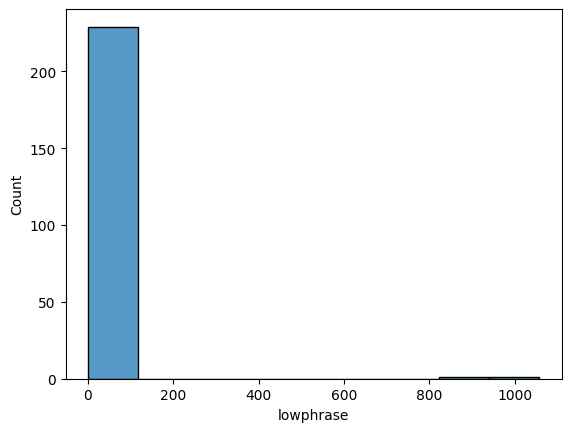

In [340]:
wfl = df1757.lowphrase.map(waarfuzgr)
wfln = wfl.loc[(wfl.notna()) & wfl!=1000]
wfreq = wfln.value_counts()
wfreq.index = wfreq.index.astype('int', copy=False)
sns.histplot(wfreq)

In [341]:
wfreq

114    1057
140     833
1        72
3        56
2        38
       ... 
75        1
112       1
48        1
191       1
26        1
Name: lowphrase, Length: 231, dtype: int64

In [380]:
wkln = wfl.loc[(wkl.notna()) & wkl!=1000]



In [403]:
dfvc = pd.DataFrame(wkln.value_counts())

In [411]:
large_groups = dfvc.loc[dfvc.lowphrase>5].index

In [420]:
large_groups

Float64Index([114.0, 140.0, 1.0, 3.0, 2.0, 171.0, 6.0, 17.0, 47.0], dtype='float64')

In [415]:
large_groups[0]

114.0

'waar op geen resolutie is'

In [432]:
for group in large_groups:
    lbl = df1757.loc[df1757.waar_fuzzy==group].groupby('phrase').max().lowphrase.iat[0]
    df1757['wfuzzy_label'] = lbl
    print(group, lbl)
    # df1757.loc[df1757.index.isin(wgr.get_group(group))])

114.0 waar of gedelibereert zynde is
140.0 waar op geen resolutie is
1.0 waar aan den selven in
3.0 waar hop haar hoogh mogende
2.0 waar aan den suppliant dan
171.0 waar te neemen waar op
6.0 waar aan sigh neevens de
17.0 waar by deselve consenteeren in
47.0 waar by versoght hadde dat


<Axes: xlabel='length_bin'>

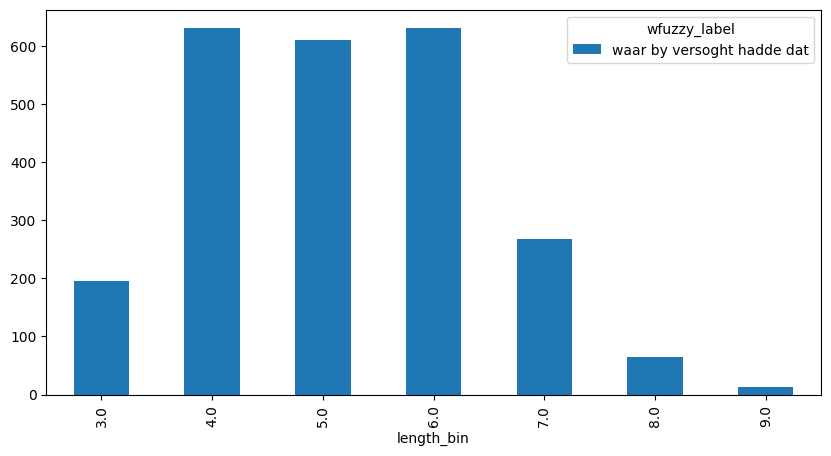

In [434]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots((2,len(large_groups)), figsize=(20, 100),)
# df1757['wkl'] = df1757.lowphrase.map(wklusgroeps)
Tot = len(large_groups)
Cols = number_of_columns

# Compute Rows required

Rows = Tot // Cols 

#     EDIT for correct number of rows:
#     If one additional row is necessary -> add one:

if Tot % Cols != 0:
    Rows += 1

ax = 
wkln = df1757.loc[(df1757.wkl.notna())] # & (df1757.wkl not in [1000,2000])]
counted = wkln.groupby(['length_bin','wfuzzy_label']).agg('count')
# wklfreq = wkln.value_counts()
# wklfreq.index = wklfreq.index.astype('int', copy=False)
# dfklf = pd.DataFrame(wklfreq)
plt.xticks(rotation = 90)
counted.doc_id.unstack().plot.bar(ax=ax)

In [364]:
wkl.

17991801   NaN
17991802   NaN
17991803   NaN
17991804   NaN
17991805   NaN
            ..
18242302   NaN
18242303   NaN
18242304   NaN
18242305   NaN
18242306   NaN
Name: lowphrase, Length: 250506, dtype: float64

In [359]:
dfklf.loc[dfklf.lowphrase>2]

,lowphrase
114,1057
140,833
1,72
3,56
2,38
171,33
6,8
17,8
47,6
105,5


In [ ]:
fig = plt.figure(figsize=(6,6))
ax = plt.subplot(aspect=1)
ax.plot(range(10)) plt.show()

In [ ]:
import seaborn as sns
sns.histplot(woverview.wklustgroeps.f)

In [191]:
waar_groups = kw2groups(df1757, keyword='waar ', contains='start')

In [192]:
start_groups = kw2groups(df1757, keyword='<start>', contains='start')

In [193]:
start_groups

{'doc_id': 0}

In [194]:
import pickle
with open('/Users/rikhoekstra/surfdrive/Republic/controle/waar_classifier.pkl','rb' ) as inmodel:
    clf = pickle.load(inmodel)

In [195]:
wdf = pd.DataFrame(waar_groups,index=[0]).transpose()

In [196]:
wdf

,0
doc_id,0


In [210]:
wgroups = gr.kw2groups(keyword='waar ', contains='start')

In [211]:
wgroups

,doc_id
lowphrase,
0 0 daar toe den,1
0 10 gesteld te zyn,1
0 aan de weduwe jacob,1
0 daar toe den raad,1
0 is na voorgaande deliberatie,1
...,...
à vos hautes puissances que,2
à vos hautes puissances un,1
à vos hautes puissances une,1


In [119]:
labeld_waar  = df1757.loc[df1757.lowphrase.isin(list(wdf.index))]

In [120]:
labeld_waar['label'] = labeld_waar['lowphrase'].map(waar_groups)

In [153]:
labeld_waar.head()


,phrase,doc_id,doc_len,pos_start,rel_pos_start,pos_end,rel_pos_end,phrase_freq,length_bin,lcats,lowphrase,label,assigned_label
17991902,WAAR op gedelibereert zynde hebben,session-1757-02-07-num-1-resolution-11,257,226,0.879377,26,0.101167,13423,6.0,medium,waar op gedelibereert zynde hebben,114,114
17992008,waar by sy hun voor,session-1757-02-07-num-1-resolution-12,493,131,0.265720,357,0.724138,1,6.0,medium,waar by sy hun voor,44,44
17992031,waar op voorschreeve Raaden der,session-1757-02-07-num-1-resolution-12,493,202,0.409736,286,0.580122,1,6.0,medium,waar op voorschreeve raaden der,155,155
17992078,waar door het quam te,session-1757-02-07-num-1-resolution-12,493,365,0.740365,123,0.249493,2,6.0,medium,waar door het quam te,61,61
17992100,WAAR op gedelibereert en in,session-1757-02-07-num-1-resolution-12,493,443,0.898580,45,0.091278,1481,6.0,medium,waar op gedelibereert en in,114,114


In [126]:
import pandas as pd
import numpy as np
from sklearn.naive_bayes import MultinomialNB
from sklearn import metrics
import sklearn.preprocessing, sklearn.decomposition, \
     sklearn.linear_model, sklearn.pipeline, sklearn.metrics, \
     sklearn.compose
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

In [136]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler
from sklearn_pandas import DataFrameMapper


In [137]:
wmapper = DataFrameMapper([
    (['rel_pos_start'], MinMaxScaler()),
    (['length_bin'], OneHotEncoder()),
    ('lowphrase', TfidfVectorizer())
])

In [138]:
np.round(wmapper.fit_transform(X=labeld_waar.copy(),y=labeld_waar['label']),2)

array([[0.88, 0.  , 0.  , ..., 0.  , 0.  , 0.41],
       [0.26, 0.  , 0.  , ..., 0.  , 0.  , 0.  ],
       [0.41, 0.  , 0.  , ..., 0.  , 0.  , 0.  ],
       ...,
       [0.17, 0.  , 0.  , ..., 0.  , 0.  , 0.  ],
       [0.59, 0.  , 0.  , ..., 0.  , 0.  , 0.  ],
       [0.9 , 0.  , 0.  , ..., 0.  , 0.  , 0.56]])

In [139]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split( labeld_waar, labeld_waar.label, test_size=0.33, random_state=42)
Xtrain = wmapper.fit_transform(X_train)

In [140]:
clf = MultinomialNB(alpha=.01)
clf.fit(Xtrain, y_train)
Xtest = wmapper.transform(X_test)
pred = clf.predict(Xtest)
X_test['assigned_label'] = pred
X_test
score = metrics.accuracy_score(y_test, pred)
print("accuracy:   %0.3f" % score)

accuracy:   0.888


In [141]:
labeld_waar['assigned_label'] = clf.predict(wmapper.transform(labeld_waar))

In [142]:
labeld_waar

,phrase,doc_id,doc_len,pos_start,rel_pos_start,pos_end,rel_pos_end,phrase_freq,length_bin,lcats,lowphrase,label,assigned_label
17991902,WAAR op gedelibereert zynde hebben,session-1757-02-07-num-1-resolution-11,257,226,0.879377,26,0.101167,13423,6.0,medium,waar op gedelibereert zynde hebben,114,114
17992008,waar by sy hun voor,session-1757-02-07-num-1-resolution-12,493,131,0.265720,357,0.724138,1,6.0,medium,waar by sy hun voor,44,44
17992031,waar op voorschreeve Raaden der,session-1757-02-07-num-1-resolution-12,493,202,0.409736,286,0.580122,1,6.0,medium,waar op voorschreeve raaden der,155,155
17992078,waar door het quam te,session-1757-02-07-num-1-resolution-12,493,365,0.740365,123,0.249493,2,6.0,medium,waar door het quam te,61,61
17992100,WAAR op gedelibereert en in,session-1757-02-07-num-1-resolution-12,493,443,0.898580,45,0.091278,1481,6.0,medium,waar op gedelibereert en in,114,114
...,...,...,...,...,...,...,...,...,...,...,...,...,...
18241776,WAAR op gedelibereert zynde is,session-1757-12-19-num-1-resolution-13,266,192,0.721805,69,0.259398,83894,6.0,medium,waar op gedelibereert zynde is,114,114
18241874,WAAR op gedelibereert zynde is,session-1757-12-19-num-1-resolution-14,162,111,0.685185,46,0.283951,83894,5.0,medium,waar op gedelibereert zynde is,114,114
18242009,waar by de Magistraat van,session-1757-12-19-num-1-resolution-16,668,114,0.170659,549,0.821856,8,7.0,large,waar by de magistraat van,14,14
18242071,waar toe de Suppliant de,session-1757-12-19-num-1-resolution-16,668,393,0.588323,270,0.404192,1,7.0,large,waar toe de suppliant de,2,2


<Axes: xlabel='assigned_label', ylabel='Count'>

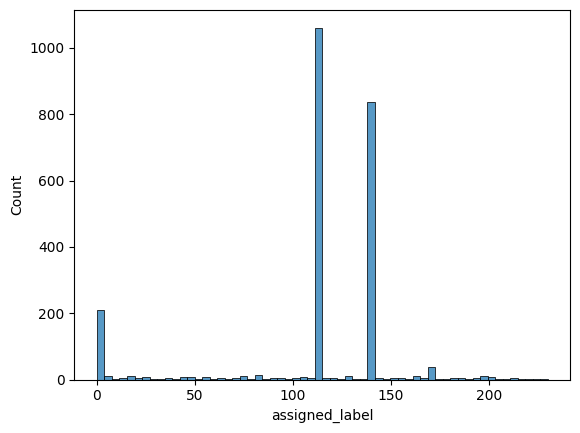

In [144]:
import seaborn as sns
sns.histplot(labeld_waar.assigned_label)

In [161]:
labeld_waar.loc[labeld_waar.assigned_label==140]

,phrase,doc_id,doc_len,pos_start,rel_pos_start,pos_end,rel_pos_end,phrase_freq,length_bin,lcats,lowphrase,label,assigned_label
17992463,WAAR op geen resolutie is,session-1757-02-09-num-1-resolution-1,41,34,0.829268,2,0.048780,66429,4.0,NaN,waar op geen resolutie is,140,140
17992487,WAAR op geen resolutie is,session-1757-02-09-num-1-resolution-2,36,29,0.805556,2,0.055556,66429,4.0,NaN,waar op geen resolutie is,140,140
17992522,WAAR op geen resolutie is,session-1757-02-09-num-1-resolution-3,44,37,0.840909,2,0.045455,66429,4.0,NaN,waar op geen resolutie is,140,140
17992561,WAAR op geen resolutie is,session-1757-02-09-num-1-resolution-4,43,36,0.837209,2,0.046512,66429,4.0,NaN,waar op geen resolutie is,140,140
17992600,WAAR op geen resolutie is,session-1757-02-09-num-1-resolution-5,43,36,0.837209,2,0.046512,66429,4.0,NaN,waar op geen resolutie is,140,140
...,...,...,...,...,...,...,...,...,...,...,...,...,...
18241555,WAAR op geen resolutie is,session-1757-12-19-num-1-resolution-6,25,18,0.720000,2,0.080000,66429,3.0,NaN,waar op geen resolutie is,140,140
18241611,WAAR op geen resolutie is,session-1757-12-19-num-1-resolution-8,43,36,0.837209,2,0.046512,66429,4.0,NaN,waar op geen resolutie is,140,140
18241628,WAAR op geen resolutie is,session-1757-12-19-num-1-resolution-9,46,39,0.847826,2,0.043478,66429,4.0,NaN,waar op geen resolutie is,140,140
18241680,WAAR op geen resolutie is,session-1757-12-19-num-1-resolution-11,28,21,0.750000,2,0.071429,66429,3.0,NaN,waar op geen resolutie is,140,140


In [158]:
freqs = labeld_waar.loc[labeld_waar['assigned_label'] == 140].length_bin.value_counts()

In [159]:
waar_groups['waar op geen resolutie is']

140

In [162]:
freqs

4.0    585
3.0    196
5.0     33
6.0     13
7.0      5
8.0      1
Name: length_bin, dtype: int64

In [62]:
wgroups = dg

dict_keys(['<start> 15 ter vergaderinge geleelen', '<start> 15 ter vergaderinge geleesen', '<start> 18 gehoort het rapport', '<start> 18 ter vergaderinge geleelen', '<start> 18 ter vergaderinge geleesen', '<start> 185 ter vergaderinge geleesen', '<start> 8 ter vergaderinge geleelen', '<start> 8 ter vergaderinge geleesen', '<start> by resumtie gedelibereert zynde', '<start> de conclusie van antwoord', '<start> de conclusie van versoeck', '<start> de griffier fagel heeft', '<start> de heere d ablaing', '<start> de heere de kempenaar', '<start> de heere pieck van', '<start> de heere van wassenaer', '<start> de heeren gedeputeerden van', '<start> de heeren nagel en', '<start> de heeren ordinaris gedeputeerden', '<start> de heeren van heeckeren', '<start> de in aanweesende heere', '<start> de n heere de', '<start> den heere d ablaing', '<start> den heere van heyden', '<start> den heere van wassenaer', '<start> dontfangen cen missive van', '<start> dontfangen een mifsive van', '<start> dontf

In [67]:
agg_group = grouped.agg({'doc_id':'count'})

In [69]:
agg_group.index

Index(['<start> 15 ter vergaderinge geleelen',
       '<start> 15 ter vergaderinge geleesen',
       '<start> 18 gehoort het rapport',
       '<start> 18 ter vergaderinge geleelen',
       '<start> 18 ter vergaderinge geleesen',
       '<start> 185 ter vergaderinge geleesen',
       '<start> 8 ter vergaderinge geleelen',
       '<start> 8 ter vergaderinge geleesen',
       '<start> by resumtie gedelibereert zynde',
       '<start> de conclusie van antwoord',
       '<start> de conclusie van versoeck', '<start> de griffier fagel heeft',
       '<start> de heere d ablaing', '<start> de heere de kempenaar',
       '<start> de heere pieck van', '<start> de heere van wassenaer',
       '<start> de heeren gedeputeerden van', '<start> de heeren nagel en',
       '<start> de heeren ordinaris gedeputeerden',
       '<start> de heeren van heeckeren', '<start> de in aanweesende heere',
       '<start> de n heere de', '<start> den heere d ablaing',
       '<start> den heere van heyden', '<start> d

In [209]:
df = FuzzyKeywordGrouper(list(agg_group.index)).vars2graph()

NameError: name 'agg_group' is not defined

In [73]:
fgroups = {e:i[0] for i in enumerate(self.df) for e in i[1]}

In [74]:
fgroups

{'<start> is ter vergaderinge geleesen': 0,
 '<start> 185 ter vergaderinge geleesen': 0,
 '<start> 8 ter vergaderinge geleesen': 0,
 '<start> 15 ter vergaderinge geleelen': 0,
 '<start> 18 ter vergaderinge geleelen': 0,
 '<start> s ter vergaderinge geleesen': 0,
 '<start> is ter vergaderinge geleelen': 0,
 '<start> 15 ter vergaderinge geleesen': 0,
 '<start> 8 ter vergaderinge geleelen': 0,
 '<start> 18 ter vergaderinge geleesen': 0,
 '<start> is gehoort het rapport': 1,
 '<start> is gehoort bet rapport': 1,
 '<start> 18 gehoort het rapport': 1,
 '<start> by resumtie gedelibereert zynde': 2,
 '<start> de conclusie van antwoord': 3,
 '<start> de conclusie van versoeck': 3,
 '<start> de griffier fagel heeft': 4,
 '<start> den heere d ablaing': 5,
 '<start> de heere d ablaing': 5,
 '<start> de heeren van heeckeren': 6,
 '<start> de heere de kempenaar': 6,
 '<start> de heere van wassenaer': 6,
 '<start> den heere van heyden': 6,
 '<start> den heere van wassenaer': 6,
 '<start> de heeren na

In [163]:
from republic.formulas.frmls.clustering import determine_klusters, kluster
from sklearn.mixture import BayesianGaussianMixture
from sklearn.preprocessing import StandardScaler
import seqsim

In [179]:
agg_group

,doc_id
lowphrase,
<start> 15 ter vergaderinge geleelen,1
<start> 15 ter vergaderinge geleesen,46
<start> 18 gehoort het rapport,4
<start> 18 ter vergaderinge geleelen,3
<start> 18 ter vergaderinge geleesen,49
<start> 185 ter vergaderinge geleesen,34
<start> 8 ter vergaderinge geleelen,1
<start> 8 ter vergaderinge geleesen,2
<start> by resumtie gedelibereert zynde,34


In [164]:
result = kluster(agg_group)

In [166]:
gresult = result.agg({'lowphrase': ['unique', 'nunique', 'count']})

In [167]:
gresult

lowphrase              
                                                  unique nunique count
label                                                                 
0                [<start> ynde ter vergaderinge getoont]       1     1
1      [<start> dontfangen cen missive van, <start> o...       3     3
2      [<start> 18 gehoort het rapport, <start> is ge...       3     3
3      [<start> den heere van heyden, <start> den hee...       2     2
4                          [<start> op de conclusie van]       1     1
5      [<start> jovis den 22 december, <start> jovis ...       2     2
6      [<start> de heere de kempenaar, <start> de hee...       2     2
7      [<start> 15 ter vergaderinge geleelen, <start>...       5     5
8      [<start> op de memorie van, <start> p de memor...       2     2
9      [<start> op het geproponeerde ter, <start> op ...       2     2
10                   [<start> ontfangen een mifsive van]       1     1
11             [<start> by resumtie gedelibereert zynde]       1     1
12     [<start> ontfangen twee missive van, <start> o...       2     2
13                     [<start> de in aanweesende heere]       1     1
14     [<start> de heeren nagel en, <start> de heeren...       3     3
15                          [<start> op de requeste van]       1     1
16     [<start> ontfangen drie missiven van, <start> ...       3     3
17     [<start> ontfangen een missive den, <start> on...       3     3
18     [<start> de heere d ablaing, <start> den heere...       2     2
19                      [<start> de heere van wassenaer]       1     1
20     [<start> de conclusie van antwoord, <start> de...       2     2
21                     [<start> de griffier fagel heeft]       1     1
22                               [<start> de n heere de]       1     1
23     [<start> dontfangen een mifsive van, <start> d...       2     2
24     [<start> 15 ter vergaderinge geleesen, <start>...       5     5
25                 [<start> de heeren gedeputeerden van]       1     1

In [182]:
waar_formules = groupdf()

KeyError: "Column(s) ['doc_id'] do not exist"

In [57]:
result


lowphrase              
                                                  unique nunique count
label                                                                 
0                [<start> ynde ter vergaderinge getoont]       1     1
1      [<start> dontfangen cen missive van, <start> o...       3     3
2      [<start> 18 gehoort het rapport, <start> is ge...       3     3
3      [<start> den heere van heyden, <start> den hee...       2     2
4                          [<start> op de conclusie van]       1     1
5      [<start> jovis den 22 december, <start> jovis ...       2     2
6      [<start> de heere de kempenaar, <start> de hee...       2     2
7      [<start> 15 ter vergaderinge geleelen, <start>...       5     5
8      [<start> op de memorie van, <start> p de memor...       2     2
9      [<start> op het geproponeerde ter, <start> op ...       2     2
10                   [<start> ontfangen een mifsive van]       1     1
11             [<start> by resumtie gedelibereert zynde]       1     1
12     [<start> ontfangen twee missive van, <start> o...       2     2
13                     [<start> de in aanweesende heere]       1     1
14     [<start> de heeren nagel en, <start> de heeren...       3     3
15                          [<start> op de requeste van]       1     1
16     [<start> ontfangen drie missiven van, <start> ...       3     3
17     [<start> ontfangen een missive den, <start> on...       3     3
18     [<start> de heere d ablaing, <start> den heere...       2     2
19                      [<start> de heere van wassenaer]       1     1
20     [<start> de conclusie van antwoord, <start> de...       2     2
21                     [<start> de griffier fagel heeft]       1     1
22                               [<start> de n heere de]       1     1
23     [<start> dontfangen een mifsive van, <start> d...       2     2
24     [<start> 15 ter vergaderinge geleesen, <start>...       5     5
25                 [<start> de heeren gedeputeerden van]       1     1

In [177]:
wdf

,0
waar aan de permissie tot,0
waar voor de permissie tot,0
waar aan den selven in,1
waar meede het selve by,1
waar van door deselve in,1
...,...
waar voor de cautie is,226
waar voor het contract was,227
waar voor men niet sonder,228
waar voor van weegens deesen,229


In [178]:
wresult = kluster(wdf)
wgresult = wresult.agg({'lowphrase': ['unique', 'nunique', 'count']})

KeyError: "Column(s) ['lowphrase'] do not exist"

In [58]:
with pd.option_context('display.max_colwidth', 800):
    display(result)

lowphrase  \
                                                                                                                                                                                               unique   
label                                                                                                                                                                                                   
0                                                                                                                                                             [<start> ynde ter vergaderinge getoont]   
1                                                                                          [<start> dontfangen cen missive van, <start> ontfangen cen missive van, <start> ontfangen van missive van]   
2                                                                                                    [<start> 18 gehoort het rapport, <start> is gehoort bet rapport, <start> is gehoort het rapport]   
3                                                                                                                                     [<start> den heere van heyden, <start> den heere van wassenaer]   
4                                                                                                                                                                       [<start> op de conclusie van]   
5                                                                                                                                          [<start> jovis den 22 december, <start> jovis den 30 juny]   
6                                                                                                                                         [<start> de heere de kempenaar, <start> de heere pieck van]   
7        [<start> 15 ter vergaderinge geleelen, <start> 18 ter vergaderinge geleelen, <start> 8 ter vergaderinge geleelen, <start> 8 ter vergaderinge geleesen, <start> is ter vergaderinge geleelen]   
8                                                                                                                                               [<start> op de memorie van, <start> p de memorie van]   
9                                                                                                                                [<start> op het geproponeerde ter, <start> op het geproponeerde van]   
10                                                                                                                                                                [<start> ontfangen een mifsive van]   
11                                                                                                                                                          [<start> by resumtie gedelibereert zynde]   
12                                                                                                                          [<start> ontfangen twee missive van, <start> ontfangen twee missiven van]   
13                                                                                                                                                                  [<start> de in aanweesende heere]   
14                                                                                           [<start> de heeren nagel en, <start> de heeren ordinaris gedeputeerden, <start> de heeren van heeckeren]   
15                                                                                                                                                                       [<start> op de requeste van]   
16                                                                                     [<start> ontfangen drie missiven van, <start> ontfangen vier missiven van, <start> ontfangen vyf missiven van]   
17                                                                                         [<start> ontfangen een missive den, <start> ontfangen een missive van, <start

In [67]:
n = determine_klusters(agg_group)[0]

In [69]:
sgr = agg_group
fgrp = {}
for i in range(n):
    iv = sgr.loc[sgr.doc_id==sgr.loc[sgr.index.isin(result['lowphrase','unique'][i])].max().iat[0]].index.values[0] # zucht
    fgrp[iv] = list(result['lowphrase','unique'][i])

In [70]:
fgrp

{'<start> 8 ter vergaderinge geleesen': ['<start> de heeren nagel en',
  '<start> de heeren ordinaris gedeputeerden',
  '<start> de heeren van heeckeren'],
 '<start> ontfangen cen missive van': ['<start> dontfangen cen missive van',
  '<start> ontfangen cen missive van',
  '<start> ontfangen van missive van'],
 '<start> is gehoort het rapport': ['<start> 18 gehoort het rapport',
  '<start> is gehoort bet rapport',
  '<start> is gehoort het rapport'],
 '<start> 15 ter vergaderinge geleelen': ['<start> de n heere de'],
 '<start> is ter vergaderinge geleelen': ['<start> 15 ter vergaderinge geleelen',
  '<start> 18 ter vergaderinge geleelen',
  '<start> 8 ter vergaderinge geleelen',
  '<start> 8 ter vergaderinge geleesen',
  '<start> is ter vergaderinge geleelen'],
 '<start> op de memorie van': ['<start> op de memorie van',
  '<start> p de memorie van'],
 '<start> ontfangen een mifsive van': ['<start> ontfangen een mifsive van'],
 '<start> 185 ter vergaderinge geleesen': ['<start> by resum

In [391]:
long_w_phrase = df_forms2.loc[df_forms2.phrase.str.find('WAAR')==0]

In [421]:
waar = pd.DataFrame(long_w_phrase.lowphrase.value_counts())

In [422]:
waar.to_csv('~/surfdrive/Republic/controle/waarphrases.csv', sep="\t", compression='gzip')

In [237]:
wcnt = pd.DataFrame(waar_phrase.lowphrase.value_counts())

In [238]:
gwaar = waar_phrase.groupby(['lowphrase'])
wcnt = gwaar.agg({'doc_id':'count', 'num'})

In [239]:
wcnt

,doc_id
lowphrase,
waar aan te neemen op,1
waar andere haar hoogh mogende,1
waar den heere van heyden,1
waar en den lieutenant bailliuw,1
waar hop haar hoogh mogende,1
waar konnen werden de twee,1
waar laatste plaats op gedelibereert,1
waar of gedelibereert zynde is,1
waar on gedelibereert zynde hebben,1


In [412]:
glwaar = long_w_phrase.groupby(['lowphrase'])
wlcnt = glwaar.agg({'doc_id':'count', 'phrase_freq':'sum'})

In [415]:
wlcnt.sort_values('phrase_freq', ascending=False)

,doc_id,phrase_freq
lowphrase,,
waar op gedelibereert zynde is,83899,7038203261
waar op geen resolutie is,66606,4412843370
waar op gedelibereert zynde hebben,13448,180177554
waar op gedelibereert zijnde is,3003,9018009
waar op gedelibereert en by,2023,4092529
...,...,...
waar omtrent op gedelibereert zynde,1,1
waar on gedelibereert zynde is,1,1
waar onder stondt accordeert met,1,1


In [394]:
wlresult = kluster(wlcnt)

In [591]:
wlresult.head(2)

,lowphrase,0,1,2,3,4,5,6,7,8,...,867,868,869,870,871,872,873,874,875,label
0,waar 0 gedelibereert zynde hebben,-5.482153,-3.951395,0.505587,0.469465,0.272493,-2.196097,-2.196075,-1.159229,-3.474034,...,0.316806,0.563318,0.229419,-1.073321,0.325091,-1.248570,-3.626970,0.036788,-1.095077,238
1,waar 0 gedelibereert zynde is,-4.611834,-4.716146,0.347826,0.263753,0.272493,-2.803640,-2.803604,-1.176499,-2.581479,...,0.044402,0.276292,-0.050063,-1.721748,0.325091,-1.581833,-0.128253,-0.938319,-1.746723,92
2,waar 15 ter vergaderinge gelesen,0.845269,0.798108,-18.703614,-10.462776,0.272493,0.787617,0.801068,0.774990,0.843960,...,0.436137,0.563318,0.701454,0.858728,0.412818,0.853351,0.760310,0.706326,0.867812,31
3,waar 185 ter vergaderinge geleesen,0.828250,0.771274,-10.111029,-19.354085,0.272493,0.760616,0.774067,0.740451,0.827021,...,0.588426,0.563318,0.649005,0.874487,0.412818,0.842789,0.760310,0.706326,0.864687,31
4,waar 2 by een brief,0.390690,0.444331,-0.874452,-0.905088,-25.981817,0.445119,0.445078,0.458316,0.391520,...,-0.912723,-1.292013,-0.789733,0.519002,-0.285300,0.576505,-0.669575,-0.935803,0.505152,99
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
868,waar wille te moogen disponeeren,0.807531,0.744441,0.314641,0.404379,-0.040059,0.747115,0.747066,0.774990,0.806400,...,0.351611,-23.410628,0.072075,0.774158,0.325091,0.821664,-0.461465,0.509403,0.825317,178
869,waar worden geordonneert om aan,0.650897,0.610274,0.281379,0.248860,0.272493,0.612105,0.612059,0.550483,0.650503,...,-0.190993,-0.186834,-23.791878,0.062475,-0.727626,0.716040,0.316028,0.475101,0.690978,251
871,waar zal werden aan de,0.503438,0.543403,-0.452465,-0.468430,-0.040059,0.544813,0.544770,0.601063,0.503738,...,-2.886109,-0.595770,-1.582014,0.393134,-19.676533,0.548168,-0.921990,-1.268040,0.511686,82
873,waar zynde hebben de heeren,-0.614936,0.533394,0.286757,0.296491,-0.040059,0.534742,0.534698,0.774990,-0.609376,...,-0.277640,-1.041033,0.157823,0.707543,-0.552173,0.476569,-19.010217,-2.490076,0.012012,15


In [632]:
ds = df1757.loc[df1757.lowphrase.str.startswith('waar') | df1757.lowphrase.str.endswith('waar')]

In [634]:
lcats = 

In [609]:
perdate.phrase

doc_id
session-1757-01-03-num-1-attendance_list    [PRAESIDE Den Heere de Kempenaar, Sabbathi den...
session-1757-01-03-num-1-resolution-1       [Envoyé aan bet Hof van, der voorleede maand h...
session-1757-01-03-num-1-resolution-10      [<START> ONtfangen een Missive van, ONtfangen ...
session-1757-01-03-num-1-resolution-11      [<START> ONtfangen een Missive van, den neegen...
session-1757-01-03-num-1-resolution-12      [<START> IS ter Vergaderinge geleesen, IS ter ...
                                                                  ...                        
session-1757-12-30-num-1-resolution-1       [<START> ONtfangen een Missive van, ONtfangen ...
session-1757-12-30-num-1-resolution-2       [<START> ONtfangen een Missive van, ONtfangen ...
session-1757-12-30-num-1-resolution-3       [<START> ONtfangen een Missive van, ONtfangen ...
session-1757-12-30-num-1-resolution-4       [<START> 185 ter Vergaderinge geleesen, 185 te...
session-1757-12-30-num-1-resolution-5       [<START> 

In [613]:
with pd.option_context('display.max_colwidth', 1800):
    phr = perdate.loc[(perdate.index.isin(ds)) ].phrase
    display(phr) 

doc_id
session-1757-02-28-num-1-resolution-20    [<START> DEn Heere van Heyden, ter Vergaderinge praesideerende heeft aan, Vergaderinge praesideerende heeft aan haar, praesideerende heeft aan haar Hoogh, heeft aan haar Hoogh Mogende, aan haar Hoogh Mogende voorgedraagen, haar Hoogh Mogende voorgedraagen en, Hoogh Mogende voorgedraagen en bekend, Mogende voorgedraagen en bekend gemaackt, voorgedraagen en bekend gemaackt dat, en bekend gemaackt dat den, bekend gemaackt dat den Heere, gemaackt dat den Heere Graave, dat den Heere Graave d, Minister Plenipotentiaris van sijne Majesteyt, Plenipotentiaris van sijne Majesteyt den, van sijne Majesteyt den Koningh, sijne Majesteyt den Koningh van, Majesteyt den Koningh van Vranckryck, den Koningh van Vranckryck by, Koningh van Vranckryck by hem, van Vranckryck by hem was, Vranckryck by hem was geweest, by hem was geweest en, hem was geweest en versoght, was geweest en versoght hadde, geweest en versoght hadde een, en versoght hadde een conferent

In [618]:
self.df.loc[self.df.formula.str.lower().str.startswith('waar')].formula.to_clipboard(sep='\t')

In [240]:
wresult = kluster(wcnt)

In [416]:
with pd.option_context('display.max_colwidth', 800):
    lres = wlresult.agg({'lowphrase': ['unique','count']})
    display(lres.sort_values(by=('lowphrase','count'), ascending=False))


lowphrase  \
                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                unique   
label                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                    
16     [waar op gedelibereert en aan, waar op gedelibereert en by, waar op gedelibereert en daar, waar op gedelibereert en de, waar op gedelibereert en den, waar op gedelibereert en door, waar op gedelibereert en een, waar op gedelibereert en en, waar op gedelibereert en haar, waar op gedelibereert en het, waar op gedelibereert en hoe, waar op gedelibereert en hy, waar op gedelibereert en in, waar op gedelibereert en is, waar op gedelibereert en jan, waar op gedelibereert en met, waar op gedelibereert en na, waar op gedelibereert en niet, waar op gedelibereert en noch, waar op gedelibereert en nog, waar op gedelibereert en oock, waar op gedelibereert en ook, waar op gedelibereert en op, waar op gedelibereert en sijn, waar op gedelibereert en te, waar op gedelibereert en ter, waar op gedeliber...   
11     [waar aldaar op gedelibereert zynde, waar jaar op gedelibereert zynde, waar op gedelibereert zyn zynde, waar op gedelibereert zynde 1, waar op gedelibereert zynde 15, waar op gedelibereert zynde 18, waar op gedelibereert zynde 3, waar op gedelibereert zynde 4, waar op gedelibereert zynde 5, waar op gedelibereert zynde als, waar op gedelibereert zynde dat, waar op gedelibereert zynde de, waar op gedelibereert zynde den, waar op gedelibereert zynde en, waar op gedelibereert zynde ende, waar op gedelibereert zynde goedgevonden, waar op gedelibereert zynde hebben, waar op gedelibereert zynde hebbende, waar op gedelibereert zynde heeft, waar op gedelibereert zynde het, waar op gedelibereert zynde il, waar op gedelibereert zynde in, waar op gedelibereert zynde is, waar op gedelibereert zynde...   
136    [waar op gedelibereert en agting, waar op gedelibereert en booven, waar op gedelibereert en bysonder, waar op gedelibereert en gehoord, waar op gedelibereert en gehoort, waar op gedelibereert en gelesen, waar op gedelibereert en gemelde, waar op gedelibereert en gepasseert, waar op gedelibereert en gesien, waar op gedelibereert en haare, waar op gedelibereert en ingenomen, waar op gedelibereert en ingenoomen, waar op gedelibereert en meede, waar op gedelibereert en nader, waar op gedelibereert en sijne, waar op gedelibereert en speciaal, waar op gedelibereert en specialijck, waar op gedelibereert en teffens, waar op gedelibereert en tusschen, waar op gedelibereert en vervolgens, waar op gedelibereert en voorts, waar op gedeliberee

In [587]:
lres.to_csv('~/surfdrive/Republic/controle/long_waarphrases',sep='\t')

In [417]:
with pd.option_context('display.max_colwidth', 800):
    # lres = wlresult.agg({'lowphrase': ['unique','count']})
    display(lres.loc[lres[('lowphrase','count')]>15])  #.sort_values(by=('lowphrase','count'), ascending=False))

lowphrase  \
                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                unique   
label                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                    
1      [waar op gedelibereert collegie ter, waar op gedelibereert de extraordinaris, waar op gedelibereert de voorschreve, waar op gedelibereert den eersten, waar op gedelibereert dertigh tot, waar op gedelibereert differenten tusschen, waar op gedelibereert gedepescheert om, waar op gedelibereert generaal der, waar op gedelibereert geschreven te, waar op gedelibereert gevonden ende, waar op gedelibereert hondert twee, waar op gedelibereert hoogh mogende, waar op gedelibereert ingenoomen de, waar op gedelibereert is gevallen, waar op gedelibereert maandt houdende, waar op gedelibereert majesteyt den, waar op gedelibereert moeten werden, waar op gedelibereert mogende met, waar op gedelibereert mogende resolutie, waar op gedelibereert om justitie, waar op gedelibereert ontfangen een, waar op ge...   
11     [waar aldaar op gedelibereert zynde, waar jaar op gedelibereert zynde, waar op gedelibereert zyn zynde, waar op gedelibereert zynde 1, waar op gedelibereert zynde 15, waar op gedelibereert zynde 18, waar op gedelibereert zynde 3, waar op gedelibereert zynde 4, waar op gedelibereert zynde 5, waar op gedelibereert zynde als, waar op gedelibereert zynde dat, waar op gedelibereert zynde de, waar op gedelibereert zynde den, waar op gedelibereert zynde en, waar op gedelibereert zynde ende, waar op gedelibereert zynde goedgevonden, waar op gedelibereert zynde hebben, waar op gedelibereert zynde hebbende, waar op gedelibereert zynde heeft, waar op gedelibereert zynde het, waar op gedelibereert zynde il, waar op gedelibereert zynde in, waar op gedelibereert zynde is, waar op gedelibereert zynde...   
14                                                                                                                                                                                                                                                                                     [waar op geen resolutie 18, waar op geen resolutie 3, waar op geen resolutie <end>, waar op geen resolutie dat, waar op geen resolutie de, waar op geen resolutie en, waar op geen resolutie haar, waar op geen resolutie het, waar op geen resolutie in, waar op geen resolutie is, waar op geen resolutie ls, waar op geen resolutie met, waar op geen resolutie s, waar op geen resolutie sy, waar op geen resolutie ten, waar op geen resolutie van, waar op geen resolutie voor

In [562]:
import pickle
with open('classifier.pkl', 'rb') as file:
    loaded_classifier = pickle.load(file)

In [565]:
from sklearn.naive_bayes import MultinomialNB
from sklearn.feature_extraction.text import CountVectorizer
from sklearn import metrics

# # Example text documents
# documents = ['Hello, how are you?',
#              'Win money, win from home.',
#              'Call me now.',
#              'Hello, Call hello you tomorrow?']

# # Class labels corresponding to the documents
# labels = ['greeting', 'spam', 'spam', 'greeting']

# Create a CountVectorizer to convert text into numerical features
vectorizer = CountVectorizer()

# # # Transform the text documents into a matrix of token counts
# # X = vectorizer.fit_transform(documents)

# # # Create a Multinomial Naive Bayes classifier
# # classifier = MultinomialNB()

# # Train the classifier
# classifier.fit(X, labels)

# # Example text for prediction
# new_documents = ['Hello, how are you doing today?']

# # Transform the new documents into the same feature matrix
# new_X = vectorizer.transform(new_documents)

# # Make predictions on the new documents
# new_predictions = classifier.predict(new_X)

# # Print the predicted class label
# print("Predicted class:", new_predictions[0])

In [584]:
ndocs = lres.loc[lres.index==11][('lowphrase','unique')]


In [585]:
ndocs = list(ndocs)
# new_X = vectorizer.transform(ndocs)
[d for d in ndocs]

[array(['waar aldaar op gedelibereert zynde',
        'waar jaar op gedelibereert zynde',
        'waar op gedelibereert zyn zynde', 'waar op gedelibereert zynde 1',
        'waar op gedelibereert zynde 15', 'waar op gedelibereert zynde 18',
        'waar op gedelibereert zynde 3', 'waar op gedelibereert zynde 4',
        'waar op gedelibereert zynde 5', 'waar op gedelibereert zynde als',
        'waar op gedelibereert zynde dat',
        'waar op gedelibereert zynde de',
        'waar op gedelibereert zynde den',
        'waar op gedelibereert zynde en',
        'waar op gedelibereert zynde ende',
        'waar op gedelibereert zynde goedgevonden',
        'waar op gedelibereert zynde hebben',
        'waar op gedelibereert zynde hebbende',
        'waar op gedelibereert zynde heeft',
        'waar op gedelibereert zynde het',
        'waar op gedelibereert zynde il', 'waar op gedelibereert zynde in',
        'waar op gedelibereert zynde is', 'waar op gedelibereert zynde l',
        '

In [583]:
# for frm in lres.iloc[0]:
ndocs = list(ndocs)
# new_X = vectorizer.transform(ndocs)

# Make predictions on the new documents
new_predictions = loaded_classifier.score(labels, ndocs)
# Print the predicted class label
print("Predicted class:", new_predictions[0])

ValueError: Expected 2D array, got 1D array instead:
array=['small' 'medium' 'large' 'verylarge'].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

In [242]:
wgrp

{'waar op gedelibereert zynde is': ['waar op gedelibereert zynde hebben',
  'waar op gedelibereert zynde hebbende',
  'waar op gedelibereert zynde heeft',
  'waar op gedelibereert zynde is'],
 'waar aan te neemen op': ['waar selver narightinge op gedelibereert'],
 'waar op gedelibereert en by': ['waar op gedelibereert en by',
  'waar op gedelibereert en gehoort',
  'waar op gedelibereert en haare',
  'waar op gedelibereert en in',
  'waar op gedelibereert en ingenoomen',
  'waar op gedelibereert en te'],
 'waar op geen resolutie is': ['waar op geen de provincie',
  'waar op geen door de',
  'waar op geen resolutie is']}

In [248]:
smpl = df_forms.loc[df_forms.phrase1.str.startswith('WAAR')].phrase1.sample(100)

In [250]:
smpl.to_clipboard()

In [87]:
df_forms = pd.read_csv('/Users/rikhoekstra/Downloads/formulas/overlap-5_gram-18th_century.tsv.gz', sep='\t',compression='infer')

In [83]:
g = wgrp['waar op gedelibereert zynde is']

In [88]:
gs = df1757[df1757.lowphrase.isin(g)]['phrase'].unique()

In [89]:
seqphrases = df_forms.loc[df_forms.phrase1.isin(gs)]

In [90]:
seqgr = seqphrases.groupby('phrase1')

In [91]:
gs

array(['WAAR op gedelibereert zynde hebben',
       'WAAR op gedelibereert zynde is', 'Waar op gedelibereert zynde is',
       'Waar op gedelibereert zynde hebben',
       'WAAR op gedelibereert zynde heeft',
       'WAAR op gedelibereert zynde hebbende'], dtype=object)

In [93]:
lg = seqgr.agg({'phrase2':lambda x: list(x)}).reset_index()

In [94]:
seqs = {}
for item in gs:
    sphrase = list(lg[lg.phrase1==item].phrase2)[0]
    seqs[item] = list(df1757[df1757.phrase.isin(sphrase)].phrase.unique())

In [95]:
seqs

{'WAAR op gedelibereert zynde hebben': ['op gedelibereert zynde hebben de',
  'op gedelibereert zynde hebben haar',
  'op gedelibereert zynde hebben hun'],
 'WAAR op gedelibereert zynde is': ['op gedelibereert zynde is goedgevonden',
  'op gedelibereert zynde is den',
  'op gedelibereert zynde is gemelden'],
 'Waar op gedelibereert zynde is': ['op gedelibereert zynde is goedgevonden'],
 'Waar op gedelibereert zynde hebben': ['op gedelibereert zynde hebben de',
  'op gedelibereert zynde hebben haar',
  'op gedelibereert zynde hebben hun'],
 'WAAR op gedelibereert zynde heeft': ['op gedelibereert zynde heeft den'],
 'WAAR op gedelibereert zynde hebbende': ['op gedelibereert zynde hebbende Heeren']}

In [96]:
lseqphrases = df_forms.loc[df_forms.phrase1.isin(seqs['WAAR op gedelibereert zynde hebben'])]

In [97]:
ns = list(lseqphrases.phrase2)

In [537]:
df1757[df1757.phrase.isin(ns)]

,phrase,doc_id,doc_len,pos_start,rel_pos_start,pos_end,rel_pos_end,phrase_freq,length_bin,lcats,lowphrase,be
17991904,gedelibereert zynde hebben de Heeren,session-1757-02-07-num-1-resolution-11,257,228,0.887160,24,0.093385,13519,6.0,medium,gedelibereert zynde hebben de heeren,"(228, 24)"
17992694,gedelibereert zynde hebben de Heeren,session-1757-02-09-num-1-resolution-7,206,119,0.577670,82,0.398058,13519,5.0,medium,gedelibereert zynde hebben de heeren,"(119, 82)"
17993373,gedelibereert zynde hebben de Heeren,session-1757-02-10-num-1-resolution-3,580,551,0.950000,24,0.041379,13519,6.0,large,gedelibereert zynde hebben de heeren,"(551, 24)"
17993955,gedelibereert zynde hebben de Heeren,session-1757-02-11-num-1-resolution-3,337,231,0.685460,101,0.299703,13519,6.0,medium,gedelibereert zynde hebben de heeren,"(231, 101)"
17995568,gedelibereert zynde hebben de Heeren,session-1757-03-01-num-1-resolution-7,290,187,0.644828,98,0.337931,13519,6.0,medium,gedelibereert zynde hebben de heeren,"(187, 98)"
...,...,...,...,...,...,...,...,...,...,...,...,...
18232474,gedelibereert zynde hebben de Heeren,session-1757-10-20-num-1-resolution-4,419,390,0.930788,24,0.057279,13519,6.0,medium,gedelibereert zynde hebben de heeren,"(390, 24)"
18234051,gedelibereert zynde hebben de Heeren,session-1757-11-01-num-1-resolution-9,135,75,0.555556,55,0.407407,13519,5.0,medium,gedelibereert zynde hebben de heeren,"(75, 55)"
18234779,gedelibereert zynde hebben de Heeren,session-1757-11-08-num-1-resolution-9,537,346,0.644320,186,0.346369,13519,6.0,large,gedelibereert zynde hebben de heeren,"(346, 186)"
18235167,gedelibereert zynde hebben de Heeren,session-1757-11-08-num-1-resolution-10,1185,719,0.606751,461,0.389030,13519,7.0,verylarge,gedelibereert zynde hebben de heeren,"(719, 461)"


In [100]:
from republic.fuzzy.fuzzy_string import score_levenshtein_similarity_ratio

In [101]:
slsr = score_levenshtein_similarity_ratio

In [102]:
slsr('op gedelibereert zynde is goedgevonden','op gedelibereert zynde is goetgevonden')

0.9736842105263158

In [621]:
seq1757

,phrase,doc_id,doc_len,pos_start,rel_pos_start,pos_end,rel_pos_end,phrase_freq,length_bin,lcats,lowphrase,0,1,2,3,4
17992360,op gedelibereert zynde is goedgevonden,session-1757-02-08-num-1-resolution-4,110,63,0.572727,42,0.381818,66393,5.0,"(100, 500]",op gedelibereert zynde is goedgevonden,op,gedelibereert,zynde,is,goedgevonden
17992904,op gedelibereert zynde is goedgevonden,session-1757-02-09-num-1-resolution-9,145,101,0.696552,39,0.268966,66393,5.0,"(100, 500]",op gedelibereert zynde is goedgevonden,op,gedelibereert,zynde,is,goedgevonden
17992994,op gedelibereert zynde is goedgevonden,session-1757-02-09-num-1-resolution-10,119,88,0.739496,26,0.218487,66393,5.0,"(100, 500]",op gedelibereert zynde is goedgevonden,op,gedelibereert,zynde,is,goedgevonden
17993457,op gedelibereert zynde is goedgevonden,session-1757-02-10-num-1-resolution-4,326,143,0.438650,178,0.546012,66393,6.0,"(100, 500]",op gedelibereert zynde is goedgevonden,op,gedelibereert,zynde,is,goedgevonden
17993681,op gedelibereert zynde is goedgevonden,session-1757-02-10-num-1-resolution-5,472,420,0.889831,47,0.099576,66393,6.0,"(100, 500]",op gedelibereert zynde is goedgevonden,op,gedelibereert,zynde,is,goedgevonden
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18241476,op gedelibereert zynde is goedgevonden,session-1757-12-15-num-1-resolution-5,344,309,0.898256,30,0.087209,66393,6.0,"(100, 500]",op gedelibereert zynde is goedgevonden,op,gedelibereert,zynde,is,goedgevonden
18241777,op gedelibereert zynde is goedgevonden,session-1757-12-19-num-1-resolution-13,266,193,0.725564,68,0.255639,66393,6.0,"(100, 500]",op gedelibereert zynde is goedgevonden,op,gedelibereert,zynde,is,goedgevonden
18241875,op gedelibereert zynde is goedgevonden,session-1757-12-19-num-1-resolution-14,162,112,0.691358,45,0.277778,66393,5.0,"(100, 500]",op gedelibereert zynde is goedgevonden,op,gedelibereert,zynde,is,goedgevonden
18241943,op gedelibereert zynde is goedgevonden,session-1757-12-19-num-1-resolution-15,260,159,0.611538,96,0.369231,66393,6.0,"(100, 500]",op gedelibereert zynde is goedgevonden,op,gedelibereert,zynde,is,goedgevonden


In [360]:
df1757['be'] = df1757.apply(lambda row: (row.pos_start, row.pos_end), axis=1)

In [541]:
df1757sort = df1757.sort_values(['doc_id','pos_start'])

In [546]:
perdate = df1757sort.groupby('doc_id').agg({'phrase':list, 'be':list, 'lcats':lambda x: x.iat[0]})

In [548]:
perdate['gaps'] = perdate.be.apply(gaps)

In [549]:
perdate

,phrase,be,lcats,gaps
doc_id,,,,
session-1757-01-03-num-1-attendance_list,"[PRAESIDE Den Heere de Kempenaar, Sabbathi den...","[(10, 54), (38, 26), (44, 20)]",small,"{10: 28, 38: 6}"
session-1757-01-03-num-1-resolution-1,"[Envoyé aan bet Hof van, der voorleede maand h...","[(13, 34), (28, 19), (35, 12), (36, 11)]",small,"{13: 15, 28: 7}"
session-1757-01-03-num-1-resolution-10,"[<START> ONtfangen een Missive van, ONtfangen ...","[(0, 113), (1, 112), (11, 102), (12, 101), (13...",medium,"{1: 10, 37: 6, 52: 6, 61: 9, 77: 10, 93: 17}"
session-1757-01-03-num-1-resolution-11,"[<START> ONtfangen een Missive van, den neegen...","[(0, 129), (15, 114), (16, 113), (17, 112), (1...",medium,"{0: 15, 50: 6, 60: 15, 75: 19, 97: 7, 104: 23}"
session-1757-01-03-num-1-resolution-12,"[<START> IS ter Vergaderinge geleesen, IS ter ...","[(0, 192), (1, 191), (2, 190), (3, 189), (4, 1...",medium,"{5: 6, 11: 8, 24: 8, 37: 9, 68: 8, 86: 10, 116..."
...,...,...,...,...
session-1757-12-30-num-1-resolution-1,"[<START> ONtfangen een Missive van, ONtfangen ...","[(0, 124), (1, 123), (8, 116), (9, 115), (10, ...",medium,"{1: 7, 43: 6, 58: 6, 69: 11, 91: 6, 97: 18, 11..."
session-1757-12-30-num-1-resolution-2,"[<START> ONtfangen een Missive van, ONtfangen ...","[(0, 425), (1, 424), (10, 415), (11, 414), (12...",medium,"{1: 9, 19: 7, 28: 24, 53: 21, 87: 15, 116: 65,..."
session-1757-12-30-num-1-resolution-3,"[<START> ONtfangen een Missive van, ONtfangen ...","[(0, 357), (1, 356), (2, 355), (3, 354), (4, 3...",medium,"{27: 6, 37: 24, 68: 6, 78: 23, 102: 6, 115: 6,..."


In [552]:
perdate.loc[perdate.waarcont.notna()]

,phrase,be,lcats,gaps,waarcont
doc_id,,,,,
session-1757-01-05-num-1-resolution-3,"[<START> ONtfangen een Missive van, by absenti...","[(0, 109), (12, 97), (13, 96), (14, 95), (15, ...",medium,"{0: 12, 33: 6, 44: 6, 51: 11, 66: 13, 79: 6, 9...",dertighsten der voorleede maand sendende
session-1757-01-07-num-1-resolution-3,"[<START> ONtfangen een Missive van, ONtfangen ...","[(0, 232), (1, 231), (2, 230), (3, 229), (4, 2...",medium,"{13: 14, 38: 8, 46: 6, 60: 7, 67: 19, 88: 6, 9...",Heere Graave van Wartensleben haar
session-1757-01-17-num-1-resolution-14,"[<START> IS ter Vergaderinge geleesen, IS ter ...","[(0, 797), (1, 796), (2, 795), (3, 794), (23, ...",large,"{3: 20, 24: 12, 38: 9, 48: 8, 57: 7, 77: 14, 9...",eerst onder het commando van
session-1757-01-26-num-1-resolution-6,"[<START> ONtfangen een Missive van, ONtfangen ...","[(0, 92), (1, 91), (7, 85), (8, 84), (9, 83), ...",small,"{1: 6, 22: 6, 30: 6, 38: 6, 46: 6, 53: 9, 72: 6}",Haren haar Hoogh Mogende Gedeputeerde
session-1757-01-26-num-1-resolution-8,"[<START> IS ter Vergaderinge geleesen, IS ter ...","[(0, 147), (1, 146), (2, 145), (3, 144), (10, ...",medium,"{3: 7, 11: 11, 25: 7, 47: 19, 77: 6, 91: 7, 12...",uyt hoofde dat sy Supplianten
...,...,...,...,...,...
session-1757-12-13-num-1-resolution-3,"[<START> ONtfangen een Missive van, ONtfangen ...","[(0, 39), (1, 38), (2, 37), (3, 36), (4, 35), ...",NaN,"{4: 6, 27: 6}",Hoogh Mogende extraordinaris Envoyé en
session-1757-12-21-num-1-resolution-4,"[<START> ONtfangen een Missive van, ONtfangen ...","[(0, 270), (1, 269), (2, 268), (3, 267), (4, 2...",medium,"{39: 6, 49: 6, 56: 6, 63: 29, 92: 6, 98: 27, 1...",Collegie ter Admiraliteyt op de
session-1757-12-27-num-1-resolution-17,"[<START> ONtfangen een Missive van, ONtfangen ...","[(0, 399), (1, 398), (2, 397), (3, 396), (4, 3...",medium,"{12: 6, 23: 6, 29: 38, 67: 6, 73: 9, 84: 14, 9...",Collegie ter Admiraliteyt in Zeeland


In [554]:
perdate.loc[perdate.lcats=='small']

,phrase,be,lcats,gaps,waarcont
doc_id,,,,,
session-1757-01-03-num-1-attendance_list,"[PRAESIDE Den Heere de Kempenaar, Sabbathi den...","[(10, 54), (38, 26), (44, 20)]",small,"{10: 28, 38: 6}",NaN
session-1757-01-03-num-1-resolution-1,"[Envoyé aan bet Hof van, der voorleede maand h...","[(13, 34), (28, 19), (35, 12), (36, 11)]",small,"{13: 15, 28: 7}",NaN
session-1757-01-03-num-1-resolution-16,"[ter Vergaderinge getoont ende geëxhibeert, Ve...","[(3, 73), (4, 72), (5, 71), (6, 70), (7, 69), ...",small,"{7: 8, 16: 6, 34: 6}",NaN
session-1757-01-03-num-1-resolution-17,"[ter Vergaderinge getoont ende geëxhibeert, Ve...","[(3, 70), (4, 69), (5, 68), (6, 67), (17, 56),...",small,"{6: 11, 18: 9}",NaN
session-1757-01-03-num-1-resolution-18,"[ter Vergaderinge geleesen de Requeste, Vergad...","[(2, 77), (3, 76), (4, 75), (5, 74), (6, 73), ...",small,"{6: 11, 20: 6, 27: 9, 46: 8, 55: 6, 65: 6}",NaN
...,...,...,...,...,...
session-1757-12-28-num-1-resolution-2,"[<START> ONtfangen twee Missiven van, ONtfange...","[(0, 50), (1, 49), (2, 48), (3, 47), (4, 46), ...",small,"{36: 6, 43: 6}",NaN
session-1757-12-28-num-1-resolution-6,"[<START> ONtfangen drie Missiven van, ONtfange...","[(0, 52), (1, 51), (2, 50), (3, 49), (4, 48), ...",small,"{22: 6, 43: 6}",NaN
session-1757-12-28-num-1-resolution-9,"[<START> ONtfangen een Missive van, ONtfangen ...","[(0, 83), (1, 82), (2, 81), (3, 80), (4, 79), ...",small,"{18: 15, 35: 11, 46: 6, 69: 6}",NaN


In [555]:
starts

,phrase,doc_id,doc_len,pos_start,rel_pos_start,pos_end,rel_pos_end,phrase_freq,length_bin,lcats,lowphrase
17991801,<START> ONtfangen een Missive van,session-1757-02-07-num-1-resolution-11,257,0,0.0,252,0.980545,122917,6.0,"(100.0, 500.0]",<start> ontfangen een missive van
17991929,<START> ONtfangen een Missive van,session-1757-02-07-num-1-resolution-12,493,0,0.0,488,0.989858,122917,6.0,"(100.0, 500.0]",<start> ontfangen een missive van
17992172,<START> ONtfangen een Missive van,session-1757-02-08-num-1-resolution-1,255,0,0.0,250,0.980392,122917,6.0,"(100.0, 500.0]",<start> ontfangen een missive van
17992302,<START> IS ter Vergaderinge geleesen,session-1757-02-08-num-1-resolution-4,110,0,0.0,105,0.954545,17339,5.0,"(100.0, 500.0]",<start> is ter vergaderinge geleesen
17992434,<START> ONtfangen een Missive van,session-1757-02-09-num-1-resolution-1,41,0,0.0,36,0.878049,122917,4.0,NaN,<start> ontfangen een missive van
...,...,...,...,...,...,...,...,...,...,...,...
18241705,<START> ONtfangen een Missive van,session-1757-12-19-num-1-resolution-13,266,0,0.0,261,0.981203,122917,6.0,"(100.0, 500.0]",<start> ontfangen een missive van
18241836,<START> ONtfangen een Missive van,session-1757-12-19-num-1-resolution-14,162,0,0.0,157,0.969136,122917,5.0,"(100.0, 500.0]",<start> ontfangen een missive van
18241913,<START> IS ter Vergaderinge geleesen,session-1757-12-19-num-1-resolution-15,260,0,0.0,255,0.980769,17339,6.0,"(100.0, 500.0]",<start> is ter vergaderinge geleesen
18241981,<START> IS ter Vergaderinge geleesen,session-1757-12-19-num-1-resolution-16,668,0,0.0,663,0.992515,17339,7.0,"(500.0, 1000.0]",<start> is ter vergaderinge geleesen


In [426]:
waar_date = waar_phrase.groupby('doc_id')

In [428]:
waar_date.agg({'be':gaps})

,be
doc_id,
session-1757-01-03-num-1-resolution-10,"({}, [(111, 111)])"
session-1757-01-03-num-1-resolution-11,"({}, [(127, 127)])"
session-1757-01-03-num-1-resolution-12,"({}, [(110, 110)])"
session-1757-01-03-num-1-resolution-18,"({}, [(40, 40)])"
session-1757-01-03-num-1-resolution-2,"({}, [(51, 51)])"
...,...
session-1757-12-29-num-1-resolution-4,"({}, [(141, 141)])"
session-1757-12-29-num-1-resolution-5,"({}, [(98, 98)])"
session-1757-12-30-num-1-resolution-1,"({}, [(122, 122)])"


In [390]:
for item in {2: 15, 17: 11, 28: 11, 42: 7, 49: 6, 62: 12, 74: 28, 108: 12, 121: 21, 143: 6, 149: 16, 169: 17, 186: 10, 196: 22, 221: 20, 245: 16, 264: 6, 277: 29, 310: 6, 324: 6, 331: 14, 346: 11, 360: 9}.keys():
    p = df1757.loc[(df1757.doc_id=='session-1757-12-30-num-1-resolution-4') & (df1757.pos_start==item)].lowphrase.iat[0]
    try:
        cl = dfjr.loc[dfjr.formula==p][['Classificatie_JR']]
        if len(cl)>0:
             print(p, cl)
    except AttributeError:
        pass

gesonden sal worden aan het      Classificatie_JR
1201              NaN


In [114]:
from more_itertools import sliding_window

In [190]:
phrasedate = pd.DataFrame(perdate.phrase.apply(l2f))

In [259]:
resolutions = phrasedate.loc[~phrasedate.index.str.contains('attendance')]

In [261]:
resolutions.phrase.explode()

doc_id
session-1757-01-03-num-1-resolution-1                              [Envoyé aan bet Hof van]
session-1757-01-03-num-1-resolution-1            [der voorleede maand houdende advertentie]
session-1757-01-03-num-1-resolution-1        [geen PRAESENTIBUS resolutie is gevallen,  De]
session-1757-01-03-num-1-resolution-10    [<START> ONtfangen een Missive van,  P, schree...
session-1757-01-03-num-1-resolution-10     [van eed teegens het geeven,  en,  neemen,  van]
                                                                ...                        
session-1757-12-30-num-1-resolution-4     [Mogende te laaten toekoomen werd,  mits,  dee...
session-1757-12-30-num-1-resolution-5     [<START> IS gehoort het rapport,  van,  de,  H...
session-1757-12-30-num-1-resolution-5     [Pieck van Zoelen en andere,  haar,  Hoog,  Mo...
session-1757-12-30-num-1-resolution-5           [in gevolge en tot voldoeninge,  van,  der]
session-1757-12-30-num-1-resolution-5     [Resolutie commissoriaal van de

In [274]:
expl = pd.DataFrame(resolutions['phrase'].explode())
expl['fullphrase'] = expl.phrase.str.join(' ')

In [275]:
expl

,phrase,fullphrase
doc_id,,
session-1757-01-03-num-1-resolution-1,[Envoyé aan bet Hof van],Envoyé aan bet Hof van
session-1757-01-03-num-1-resolution-1,[der voorleede maand houdende advertentie],der voorleede maand houdende advertentie
session-1757-01-03-num-1-resolution-1,"[geen PRAESENTIBUS resolutie is gevallen, De]",geen PRAESENTIBUS resolutie is gevallen De
session-1757-01-03-num-1-resolution-10,"[<START> ONtfangen een Missive van, P, schree...",<START> ONtfangen een Missive van P schreeven...
session-1757-01-03-num-1-resolution-10,"[van eed teegens het geeven, en, neemen, van]",van eed teegens het geeven en neemen van
...,...,...
session-1757-12-30-num-1-resolution-4,"[Mogende te laaten toekoomen werd, mits, dee...",Mogende te laaten toekoomen werd mits deesen...
session-1757-12-30-num-1-resolution-5,"[<START> IS gehoort het rapport, van, de, H...",<START> IS gehoort het rapport van de Heeren
session-1757-12-30-num-1-resolution-5,"[Pieck van Zoelen en andere, haar, Hoog, Mo...",Pieck van Zoelen en andere haar Hoog Mogend...


In [311]:
from republic.formulas.frmls.clustering import kluster_by_phrase

In [312]:
gdg = kluster_by_phrase(df1757, 'lowphrase', pat='goe[dt]+ge[vu]+onden')

In [314]:
with pd.option_context('display.max_colwidth', 800):
    display(gdg)

lowphrase  \
                                                                                                                                                                                                                                                                                                                                                       unique   
label                                                                                                                                                                                                                                                                                                                                                           
0                                                                                                                                                                                                                                                                             [dertigh is goedgevonden en geordonneert, is goedgevonden en geordonneert waar]   
1                                                                                                                                                                          [doen is goedgevonden en verstaan, geeven is goedgevonden en verstaan, waaren is goedgevonden en verstaan, werden is goedgevonden en verstaan, worden is goedgevonden en verstaan]   
2                                                                                                                                                                                                                                                               [is naar voorgaande deliberatie goedgevonden, na vyftigh voorgaande deliberatie goedgevonden]   
3                                                                                                                                                                                                                                                                          [niet was goedgevonden het voorschreeve, was goedgevonden het voorschreeve tweede]   
4      [goedgevonden en verstaan aan gemelde, goedgevonden en verstaan alvoorens in, goedgevonden en verstaan by provisie, goedgevonden en verstaan de gemelde, goedgevonden en verstaan de heeren, goedgevonden en verstaan den fiscaal, goedgevonden en verstaan den gemelden, goedgevonden en verstaan gemelde heere, goedgevonden en verstaan haar hoogh]   
...                                                                                                                                                                                                                                                                                                                                                       ...   
217                                                                                                                                                                                                                                                                                                                  [mogende goedgevonden hadden de gemelde]   
218                                                                                                                                                                                                                                                                                                                [loopende maand houdende dat goedgevonden]   
219                                                                                                                                                                                                                                                                                                                [geëxamineert hebbende is goedgevonden en]   
220                                                                                                     

In [317]:
gdg['lowphrase','unique']

label
0      [dertigh is goedgevonden en geordonneert, is g...
1      [doen is goedgevonden en verstaan, geeven is g...
2      [is naar voorgaande deliberatie goedgevonden, ...
3      [niet was goedgevonden het voorschreeve, was g...
4      [goedgevonden en verstaan aan gemelde, goedgev...
                             ...                        
217             [mogende goedgevonden hadden de gemelde]
218           [loopende maand houdende dat goedgevonden]
219           [geëxamineert hebbende is goedgevonden en]
220    [voorgaande deliberatie goetgevonden ende vers...
221    [gelderland is goedgevonden en verstaan, gemel...
Name: (lowphrase, unique), Length: 222, dtype: object

In [309]:
gdgvgphrase  = df1757.loc[df1757.lowphrase.str.contains('goe[dt]+ge[vu]+onden en versta.?n',regex=True)]
gphrase =  gdgvgphrase.groupby(['lowphrase'])
lcnt = gphrase.agg({'doc_id':'count'})
# lcnt = df1757.loc[df1757.lowphrase.str.contains('goe[dt]+ge[vu]+onden en versta.?n',regex=True)].lowphrase.value_counts()

In [294]:
dflcnt = pd.DataFrame(lcnt)

In [278]:
gcnt = goetgevonden.value_counts('fullphrase')
gcnt

fullphrase
WAAR op gedelibereert zynde is  goedgevonden  en  verstaan  dat                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                  12
WAAR op gedelibereert zynde is  goedgevonden  en  verstaan  dat  Copie  van  de                                                                          

In [299]:
gcluster = kluster(lcnt)

In [319]:
df1757['be'] = df1757.apply(lambda row: (row.pos_start, row.pos_end), axis=1)
    

,phrase,be,idx
doc_id,,,
session-1757-01-03-num-1-attendance_list,"[PRAESIDE Den Heere de Kempenaar, Sabbathi den...","[(10, 54), (38, 26), (44, 20)]","[(10, 54), (20, 26)]"
session-1757-01-03-num-1-resolution-1,"[Envoyé aan bet Hof van, der voorleede maand h...","[(13, 34), (28, 19), (35, 12), (36, 11)]","[(13, 34), (11, 19), (34, 12), (19, 11)]"
session-1757-01-03-num-1-resolution-10,"[<START> ONtfangen een Missive van, ONtfangen ...","[(0, 113), (1, 112), (11, 102), (12, 101), (13...","[(0, 113), (0, 112), (55, 53), (54, 52), (53, ..."
session-1757-01-03-num-1-resolution-11,"[<START> ONtfangen een Missive van, den neegen...","[(0, 129), (15, 114), (16, 113), (17, 112), (1...","[(0, 129), (0, 114), (70, 54), (69, 35), (54, ..."
session-1757-01-03-num-1-resolution-12,"[<START> IS ter Vergaderinge geleesen, IS ter ...","[(0, 192), (1, 191), (2, 190), (3, 189), (4, 1...","[(0, 192), (96, 94), (95, 93), (94, 92), (93, ..."
...,...,...,...
session-1757-12-30-num-1-resolution-1,"[<START> ONtfangen een Missive van, ONtfangen ...","[(0, 124), (1, 123), (8, 116), (9, 115), (10, ...","[(0, 124), (0, 123), (60, 58), (59, 57), (58, ..."
session-1757-12-30-num-1-resolution-2,"[<START> ONtfangen een Missive van, ONtfangen ...","[(0, 425), (1, 424), (10, 415), (11, 414), (12...","[(0, 425), (217, 207), (216, 199), (207, 198),..."
session-1757-12-30-num-1-resolution-3,"[<START> ONtfangen een Missive van, ONtfangen ...","[(0, 357), (1, 356), (2, 355), (3, 354), (4, 3...","[(0, 357), (187, 153), (186, 152), (153, 151),..."


In [ ]:
import pickle

# Save the trained classifier to a file
with open('classifier.pkl', 'wb') as file:
    pickle.dump(classifier, file)

# Load the classifier from the file
with open('classifier.pkl', 'rb') as file:
    loaded_classifier = pickle.load(file)

# Use the loaded classifier for predictions
new_data = [[5.1, 3.5, 1.4, 0.2], [6.2, 2.9, 4.3, 1.3]]
predictions = loaded_classifier.predict(new_data)
print(predictions)

In [192]:
expl.phrase = expl.phrase.apply(lambda x: x[0])

In [196]:

for i in range(n):
    rx = sts.loc[sts.index.isin(result['phrase','unique'][i])]
    mx = sts.loc[sts.index.isin(result['phrase','unique'][i]).max().iat[0]].index.values[0]
    # d = sts.loc[sts.doc_id==mx]
    print(i,rx,mx ,d)

KeyError: ('phrase', 'unique')

In [420]:
sts[sts.doc_id>5]

,doc_id
lowphrase,
waar op gedelibereert en by,30
waar op gedelibereert en in,15
waar op gedelibereert zynde hebben,213
waar op gedelibereert zynde is,766
waar op geen resolutie is,833


NameError: name 'ivr' is not defined

In [2]:
for i in range(n):
    xgrp = sts.index.isin(result['phrase','unique'][i])
    mx = sts.loc[xgrp].max().iat[0]
    ivr = sts.loc[sts.doc_id==mx]
    iv = ivr.index.values[0]
    print(i, iv)

NameError: name 'n' is not defined

In [200]:
sts.index.isin(result['phrase','unique'][i])

KeyError: ('phrase', 'unique')

In [198]:
fgrp = {}
xgrp = sts.index.isin(result['phrase','unique'][i])
mx = sts.loc[xgrp].max()
iv = sts.loc[sts.doc_id==agg_group]
fgrp[iv] = list(result['phrase','unique'][i])

SyntaxError: invalid syntax (1723157123.py, line 4)

In [235]:
wresult

lowphrase              
                                                  unique nunique count
label                                                                 
0      [waar op gedelibereert zynde hebben, waar op g...       4     4
1                              [waar op en voorts meede]       1     1
2                             [waar op geen gevonden en]       1     1
3      [waar op gedelibereert en by, waar op gedelibe...       6     6
4      [waar andere haar hoogh mogende, waar hop haar...       2     2
5                      [waar en den lieutenant bailliuw]       1     1
6                       [waar ten genoomen zyn geleesen]       1     1
7                            [waar den heere van heyden]       1     1
8      [waar of gedelibereert zynde is, waar on gedel...       6     6
9                           [waar konnen werden de twee]       1     1
10                              [waar op en by resumtie]       1     1
11                               [waar aan te neemen op]       1     1
12                               [waar op voor als nogh]       1     1
13     [waar op geen de provincie, waar op geen door ...       3     3
14                [waar laatste plaats op gedelibereert]       1     1
15            [waar selver narightinge op gedelibereert]       1     1

In [204]:
wcnt.get()

,doc_id
phrase,
0 0 daar toe den,1
0 10 gesteld te zyn,1
0 aan de Weduwe Jacob,1
0 selver Resolutie van den,1
1 2 3 en 4,1
...,...
à Vos Hautes Puissances que,2
à Vos Hautes Puissances un,1
à Vos Hautes Puissances une,1


In [216]:
wresult.columns

MultiIndex([('lowphrase',  'unique'),
            ('lowphrase', 'nunique'),
            ('lowphrase',   'count')],
           )

In [219]:
wcnt

,doc_id
phrase,
0 0 daar toe den,1
0 10 gesteld te zyn,1
0 aan de Weduwe Jacob,1
0 selver Resolutie van den,1
1 2 3 en 4,1
...,...
à Vos Hautes Puissances que,2
à Vos Hautes Puissances un,1
à Vos Hautes Puissances une,1


In [255]:
agg_group[(agg_group.doc_id>20)]

,doc_id
lowphrase,
<start> 15 ter vergaderinge geleesen,46
<start> 18 ter vergaderinge geleesen,49
<start> 185 ter vergaderinge geleesen,34
<start> by resumtie gedelibereert zynde,34
<start> de heeren gedeputeerden van,51
<start> dontfangen een missive van,26
<start> is gehoort het rapport,72
<start> is ter vergaderinge geleelen,22
<start> is ter vergaderinge geleesen,252


In [142]:
len(agg_group)

53

In [143]:
df_forms2['lowphrase']=df_forms2.phrase.str.lower()

In [144]:
df_forms2.to_parquet('/Users/rikhoekstra/Downloads/formulas/phrases-5_gram-18th_century.parquet.gz')

In [145]:
len(nostarts)

247940

In [146]:
strt = nostarts.loc[nostarts.pos_start<10]

In [148]:
s1 = set(starts.doc_id.unique())
s2 = set(df_forms2.doc_id.unique())
docnotinstart =  s2-s1

In [149]:
len(docnotinstart)

306805

In [150]:
docwlinstart = s2&s1

In [151]:
len(docwlinstart)

2376

In [152]:
len([d for d in docnotinstart if d.find('attendance')==-1])

281494

In [253]:
self.df.to_clipboard()

so this means that 